# Course Description 

Bayesian data analysis is an increasingly popular method of statistical inference, used to determine conditional probability without having to rely on fixed constants such as confidence levels or p-values. In this course, you’ll learn how Bayesian data analysis works, how it differs from the classical approach, and why it’s an indispensable part of your data science toolbox. You’ll get to grips with A/B testing, decision analysis, and linear regression modeling using a Bayesian approach as you analyze real-world advertising, sales, and bike rental data. Finally, you’ll get hands-on with the PyMC3 library, which will make it easier for you to design, fit, and interpret Bayesian models. 

# Table of contents 

- ## 1. The Bayesian way

    - ### Who is Bayes? What is Bayes?
    
    - ### Probability and Bayes' Theorem
    
    - ### Testing the Bayes 

- ## 2. Bayesian estimation 

    - ### Under the Bayesian hood
    
    - ### Prior belief
    
    - ### Reporting Bayesian results 

- ## 3. Bayesian inference 

    - ### A/B testing 
    
    - ### Decision analysis 
    
    - ### Regression and forecasting 

- ## 4. Bayesian linear regression with pyMC3

    - ### Markov Chain Monte Carlo and model fitting 
    
    - ### Interpreting results and comparing models 
    
    - ### Making predictions 
    
    - ### How much is an avocado? 

----
### Libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.stats import uniform
from scipy.stats import binom

### Datasets

In [2]:
path = '/Users/wenwen/Courses/ONLINE/DataCamp/data/'

file_bike = 'bikes_test.csv'
file_ads = 'ads.csv'

ads = pd.read_csv(path + file_ads)

---
# 1. The Bayesian Way


## Who is Bayes? What is Bayes?

Bayesian inference means updating one's belief about something as the new information becomes available. 

One might update their belief about the parameters of a statistical model based on incoming data. 

#### What is Bayes?

This Bayesian approach to statistical inference is quite different from the more common frequentist or classical approach in two major ways. 

- First, in the meaning of the word "probability". For frequentists, probability is the proportion of outcomes. In 6000 dice rolls, approximately 1000 rolls would come up 6. That's why the probability of rolling a 6 is 1/6. For a Bayesian, on the other hand, probability means a degree of belief. A valid Bayesian statement of probability might be "I am 90% sure this model's parameter should be larger than 1". 

- The second difference between the two approaches is in the nature of the parameters of statistical models. For frequentists, they are simply fixed values. For Bayesians, parameters are random variables. This means they can be described by probability distributions and can take many different values with different probabilities. 

These two differences are what makes the Bayesian approach so appealing! 

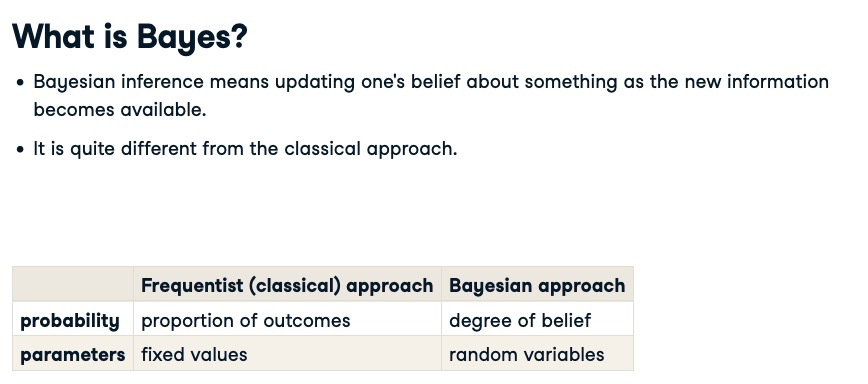

#### It pays to go Bayes! 

- First, since the parameters have distributions, the Bayesian approach can naturally handle `uncertainty`. If a distribution of a parameter describes many different values as equally likely, for instance, the uncertainty is large. 

- Second, since probability is defined as a degree of belief, it's easy to include `expert opinion or domain knowledge` in a Bayesian model in a statistically sound way. 

There are many other reasons to go Bayes as well: 

- Bayesian inference `does not rely on fixed constants such as p-values`, a common critique on the classical approach. 

- Bayesian inference is statistically correct even with little data, and finally, 

- It often coincides with the frequentist results, but offers more flexibility to build custom models. 

#### Probability distributions 

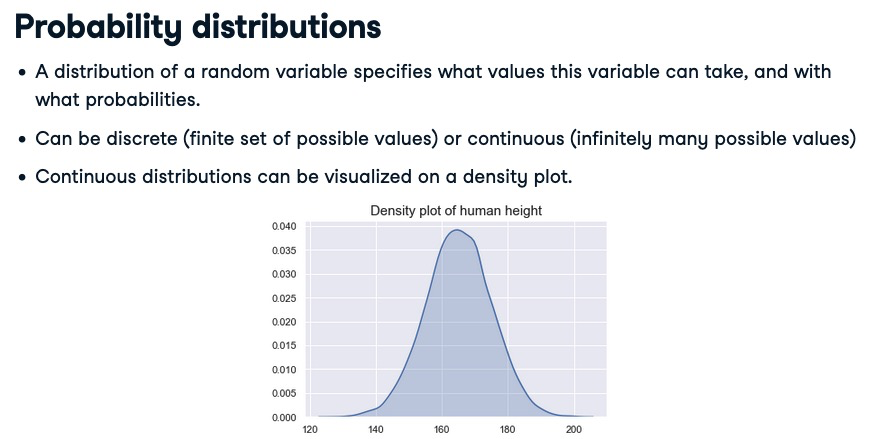

#### Distributions in Python 

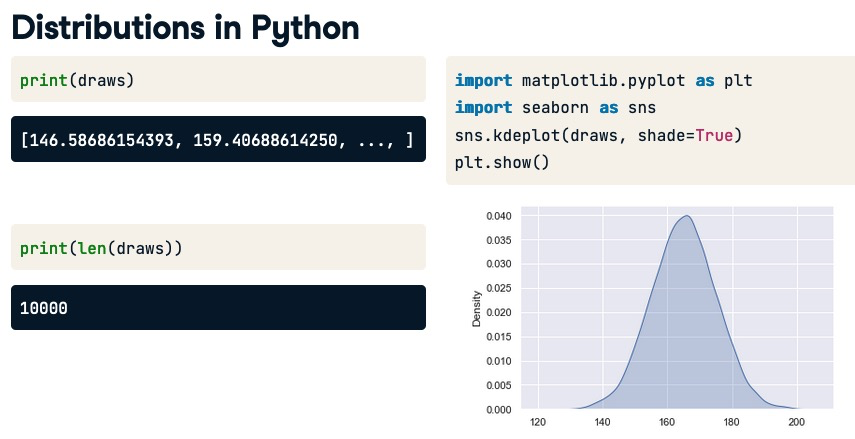

### Exercise: Bayesians vs. Frequentists 

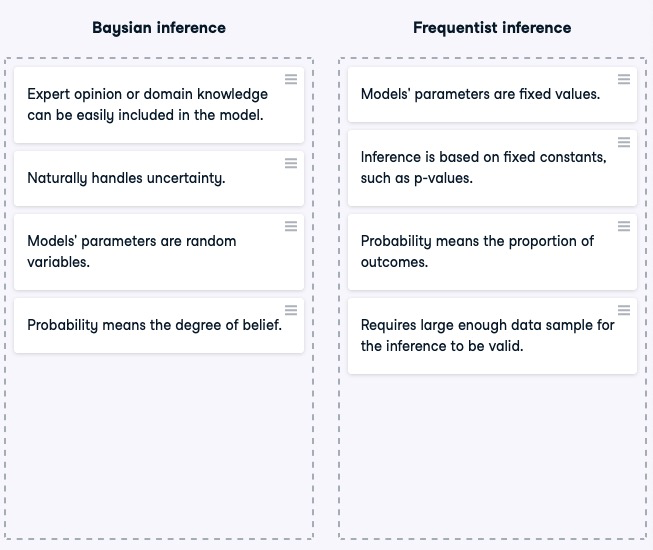

## Probability and Bayes' Theorem

#### Probability theory

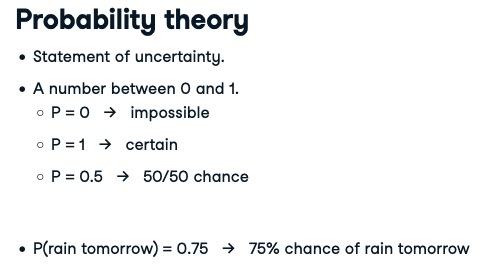

#### Probability rules 

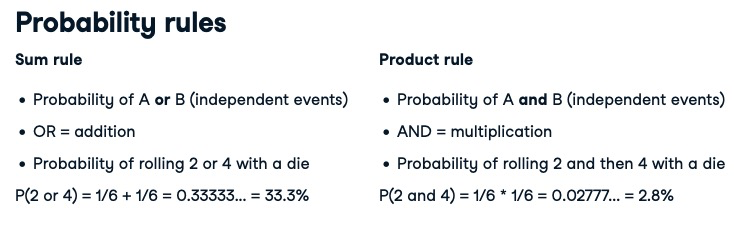

#### Conditional probability 

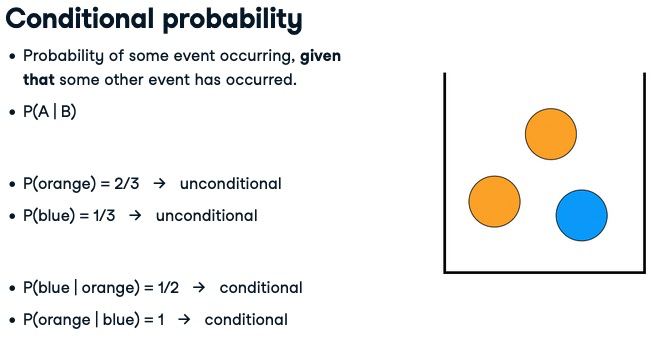

#### Bayes' Theorem in practice 

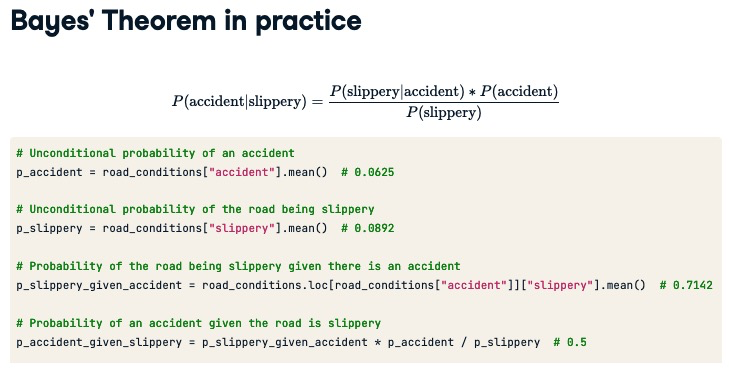

### Exercise: Bayesian spam filter

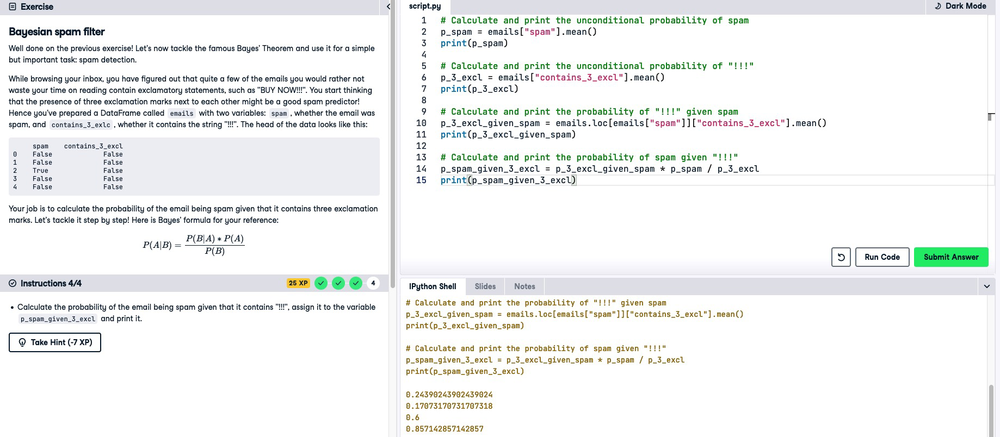

---
## Tasting the Bayes

#### Binomial distribution 

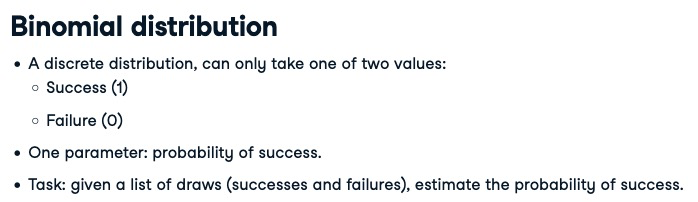

#### Binomial distribution in Python 

Number of successes in 100 trials:

In [3]:
np.random.binomial(100, 0.5)

50

In [4]:
np.random.binomial(100, 0.5)

56

Get draws from a binomial:

In [5]:
np.random.binomial(1, 0.5, size=5)

array([0, 1, 0, 1, 1])

#### Heads probability

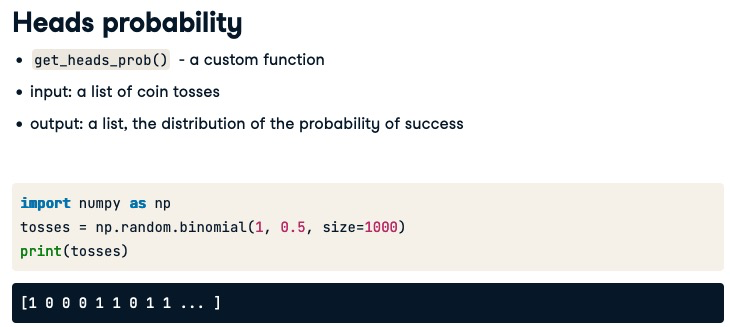

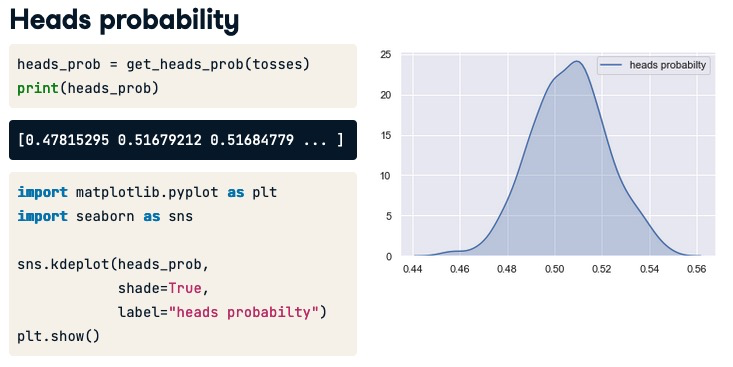

### Exercise: The more you toss, the more you learn

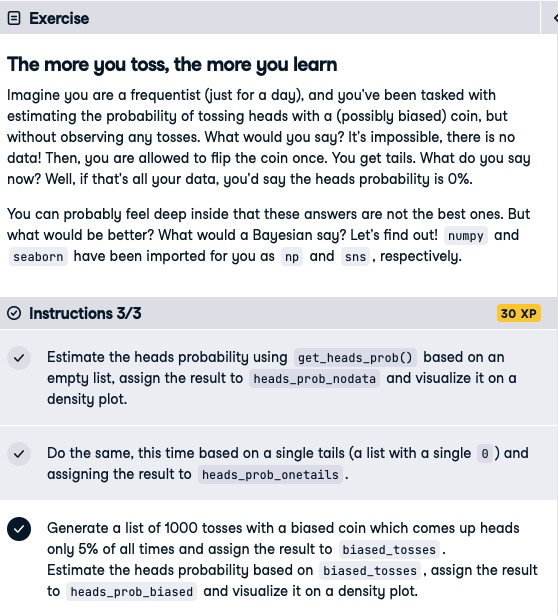

**Take away:** With no data, each possible value of the heads probabilty is equally likely! That's the Bayesian way of saying 'we don't know'. Having seen a single tails, the model suspects that tails is more likely than heads, but since there is so little data, it is not very sure about it, so other values are possible, too. Having seen 1000 tosses, 5% of them heads, the model is certain: the heads probability is around 5%. You have just witnessed the Bayesian approach at its core: as more data come in, we update our belief about the parameter, and with more data we become more certain about our estimate!

---
# 2. Bayesian estimation 

## Under the Bayesian hood

#### Bayes' Theorem revisited 

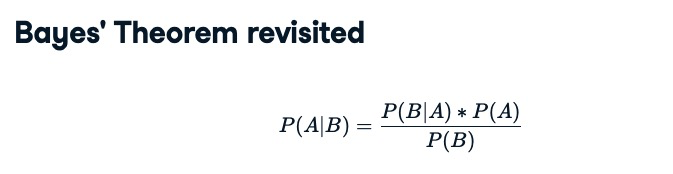

#### It can also be used to estimate model parameters

Here, each of the probabilities in the formula denotes a probability distribution rather then a single number. 

The term on the left-hand side is what we are interested in: the `posterior distribution`, reflecting our knowledge about the parameters given the data we have. 

On the right-hand side, we have the `prior distribution`, which is what we know about the parameters before seeing any data, multiplied with the likelihood, which says how likely the data is given the parameters. 

The whole thing is divided by a scaling factor to make sure it is a proper distribution that sums up to one. Don't worry if this seems abstract now, as we will demonstrate it next with an example. Previously you used the get-heads-prob function, which returns the draws from the posterior distribution. Now, let's calculate this distribution exactly using Bayes' Theorem and a technique called `grid approximation`. 

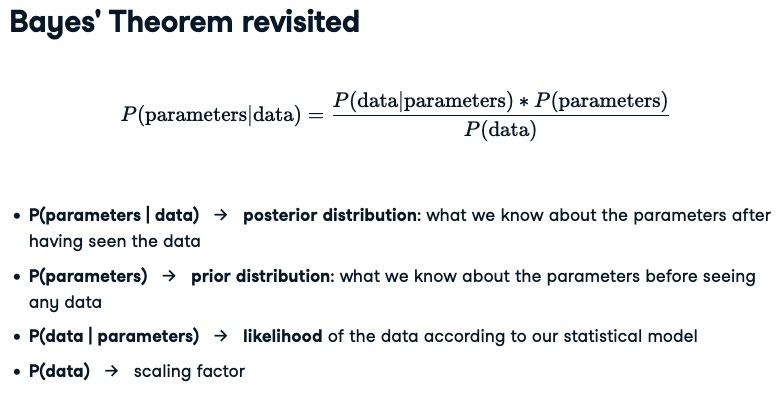

---
#### Tossing the coin again: grid approximation 

Consider this question: **what's the probability of tossing heads with a coin, if we observed 75 heads in 100 tosses?** 

We start the grid approximation by creating **a grid of all possible combinations of the number of heads in 100 tosses and the probability of tossing heads**. Obviously, we cannot list all probabilities from 0 to 1, so we'll make a grid by 1 percentage point. We can create the grids with numpy-dot-arange and list all combinations of the two using a list comprehension that loops over both arrays. Finally, we make it a DataFrame and call it "coin". 

In [6]:
num_heads = np.arange(0, 101, 1)
head_prob = np.arange(0, 1.01, 0.01)

coin = pd.DataFrame([(x, y) for x in num_heads for y in head_prob])
coin.columns = ['num_heads', 'head_prob']

coin

,num_heads,head_prob
0,0,0.00
1,0,0.01
2,0,0.02
3,0,0.03
4,0,0.04
...,...,...
10196,100,0.96
10197,100,0.97
10198,100,0.98
10199,100,0.99


#### Tossing the coin again: grid approximation

Now, we need a **prior**: what we know about the probability of tossing heads before seeing any data. Say we know nothing, it could be anything between 0 and 1. In that case, uniform distribution is the right prior choice. We can import it from scipy-dot-stats, and then use its pdf method (which stands for probability density function) to get the prior probability for each head-prob value in the "coin" DataFrame. 

In [7]:
coin['prior'] = uniform.pdf(coin['head_prob'])

#### Tossing the coin again: grid approximation

Next, the **likelihood**. We will model coin flips using a binomial distribution, so we import it from scipy-dot-stats. It has a `pmf` method which stands for `probability mass function`. 

It's like a pdf for discrete distributions. It takes three arguments: the number of heads, the total number of tosses, and the heads probability. We compute the likelihood for each row in the DataFrame. 


<span style='color:red'>Equation?<span/>

In [8]:
coin['likelihood'] = binom.pmf(coin['num_heads'], 100, coin['head_prob'])

In [9]:
coin

,num_heads,head_prob,prior,likelihood
0,0,0.00,1.0,1.000000
1,0,0.01,1.0,0.366032
2,0,0.02,1.0,0.132620
3,0,0.03,1.0,0.047553
4,0,0.04,1.0,0.016870
...,...,...,...,...
10196,100,0.96,1.0,0.016870
10197,100,0.97,1.0,0.047553
10198,100,0.98,1.0,0.132620
10199,100,0.99,1.0,0.366032


#### Tossing the coin again: grid approximation

Consider the first row. The likelihood is 1 because if the heads probability is 0, then observing 0 heads in 100 tosses is 100% likely. In the second row, the heads probability is only slightly above zero. In this scenario, the likelihood of observing 0 heads in 100 tosses is almost 37%. 

#### Tossing the coin again: grid approximation

Next, we follow Bayes' formula: we multiply the prior with the likelihood and scale by the product's sum to get the posterior probabilities. 

The division-assignment operator overwrites the posterior_prob column with itself divided by its own sum. 

In [10]:
coin['posterior_prob'] = coin['prior'] * coin['likelihood']
coin['posterior_prob'] /= coin['posterior_prob'].sum()

#### Tossing the coin again: grid approximation - taking together 

In [11]:
from scipy.stats import binom
from scipy.stats import uniform

num_heads = np.arange(0, 101, 1)
head_prob = np.arange(0, 1.01, 0.01)

coin = pd.DataFrame([(x, y) for x in num_heads for y in head_prob])
coin.columns = ['num_heads', 'head_prob']

coin['prior'] = uniform.pdf(coin['head_prob'])
coin['likelihood'] = binom.pmf(coin['num_heads'], 100, coin['head_prob'])

coin['posterior_prob'] = coin['prior'] * coin['likelihood']
coin['posterior_prob'] /= coin['posterior_prob'].sum()

#### Plotting posterior distribution 

`Question: What's the probability of tossing heads with a coin, if we observed 75 heads in 100 tosses?`

Finally, we can answer our question! 

We take only rows with num-heads equal to 75 and scale the posterior again to make sure it sums up to one. 

We can use the seaborn-lineplot function to plot different probabilities of tossing heads on the horizontal axis against their posterior probabilities on the vertical axis. 

/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


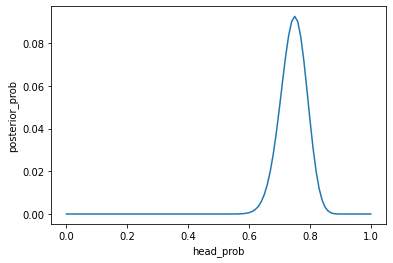

In [12]:
heads75 = coin.loc[coin['num_heads'] == 75]
heads75['posterior_prob'] /= heads75['posterior_prob'].sum()

sns.lineplot(x=heads75['head_prob'], y=heads75['posterior_prob'])
plt.show()

---
### Exercise: Towards grid approximation 

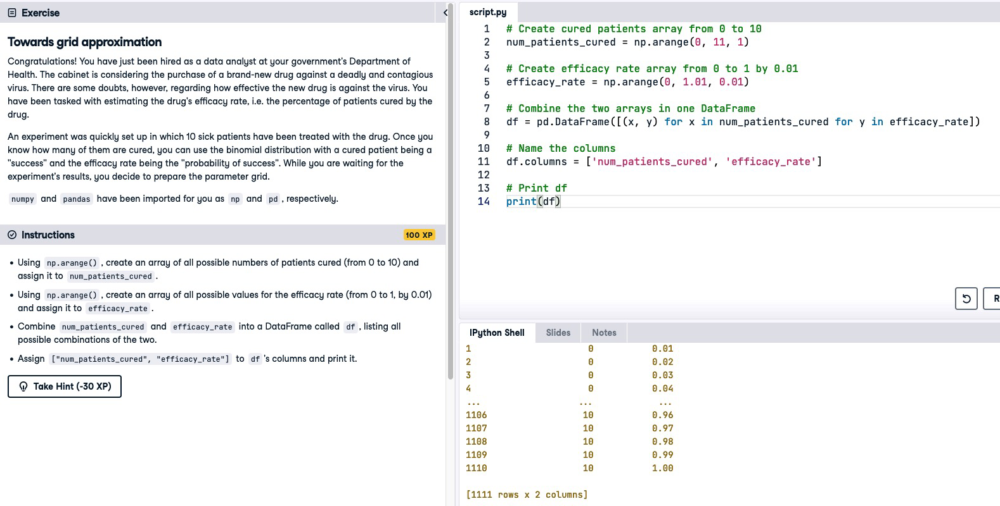

---
### Exercise: Grid approximation without prior knowledge

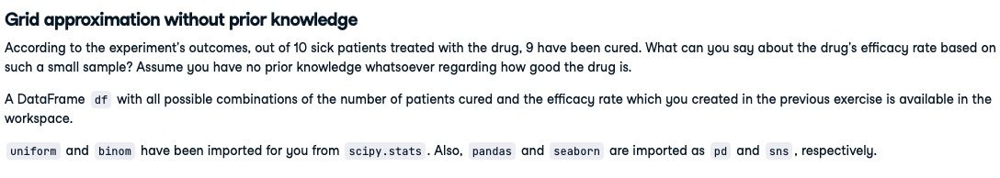

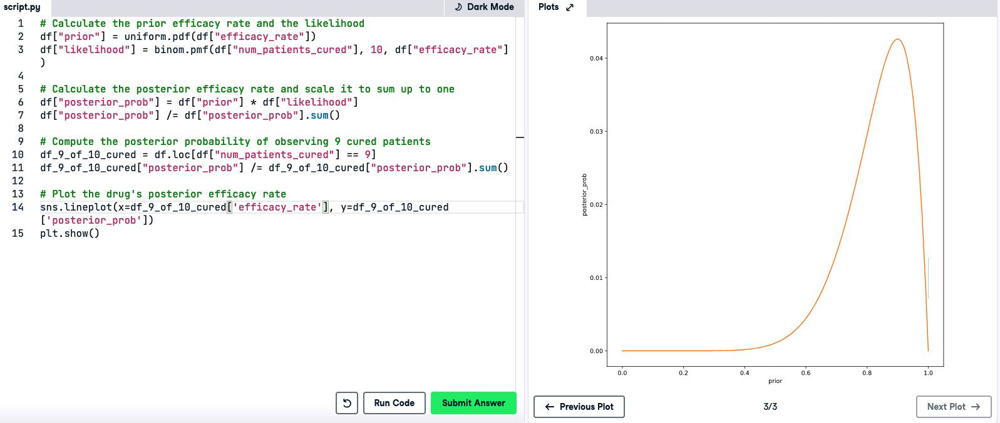

#### Take-away:

As we might have expected, observing 9 out of 10 patients cured results in the posterior efficacy rate of 90% being very likely. Notice, however, how much uncertainty there is in the posterior distribution: even the efficacy of 50% is plausible. This is the result of a very small data sample and a great example of how Bayesian parameter estimates incorporate uncertainty!

---
### Exercise: Updating posterior belief 

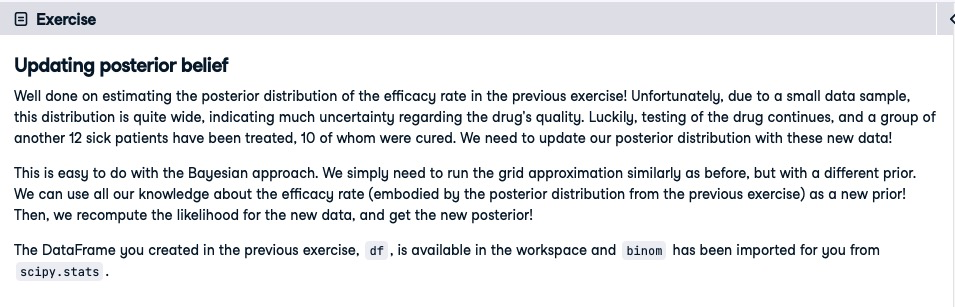

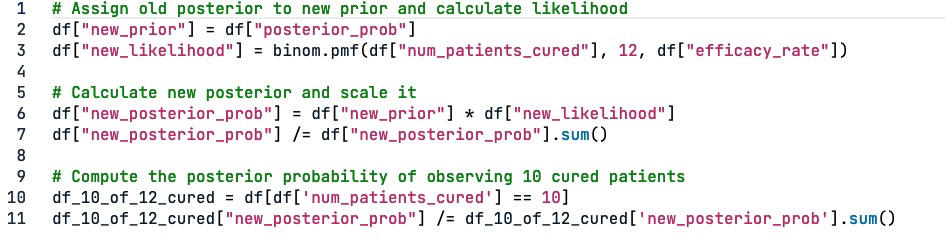

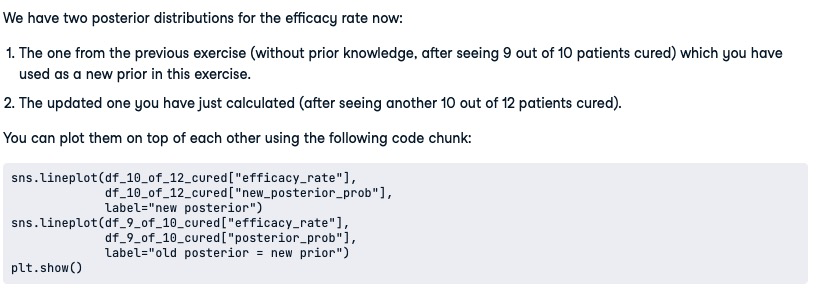

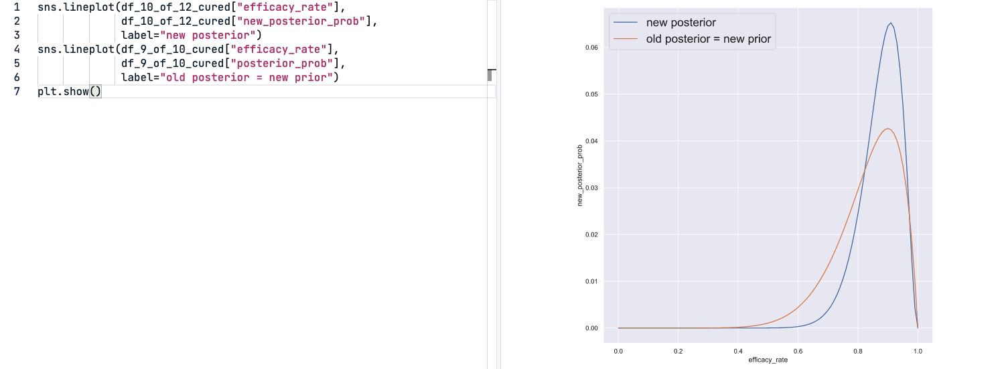

#### Take-away:

The difference between these two distributions actually reflects what we have learned only from the data on the 12 new patients. The knowledge about the first 10 patients is already encoded in the old posterior, which became the new prior.

Instead of using the old posterior as a new prior, we could have come up with our own prior belief about the efficacy rate in the first place. 

---
## Prior belief 

#### Prior distribution 

Prior distribution reflects what we know about the parameters we want to estimate before observing any data. 

We could know nothing and choose the uniform prior, where all parameter values are equally likely. 

A posterior from a previous analysis can also be used as a new prior to update the posterior as more data came in. 

In general, however, one can choose any probability distribution as a prior. This allows us to include external information in the model, such as expert opinion, common knowledge, previous research results, or even our own beliefs. 

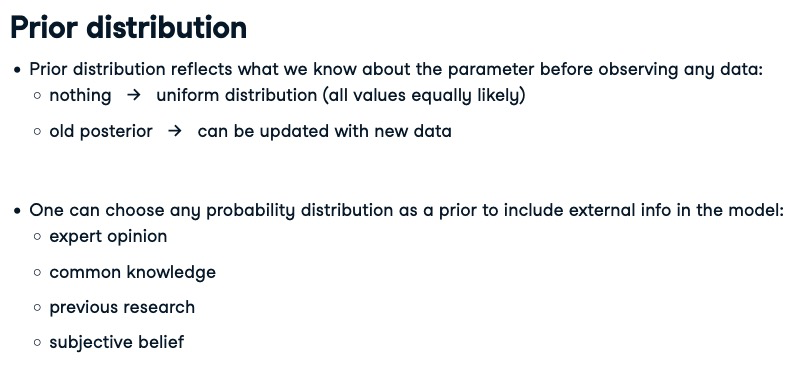

---
#### Prior's impact 

Consider a coin toss again. We choose a uniform prior, shown in blue, which assumes that all heads-probabilities between 0% and 100% are equally likely. We toss twice and get one heads and one tails. The posterior, shown in orange, is quite similar to the prior. It looks like a heads-probability around 50% is most likely, but other values are also possible. This is because there is not enough data to learn from - almost all we know is the prior. We toss once more and get a heads. The posterior moves slightly to the right, indicating that heads is more likely than tails, although other values of heads-probability are still possible. As we get more data, the posterior becomes narrower and higher. With much more data, this effect is even stronger, and the prior plays a smaller role. 

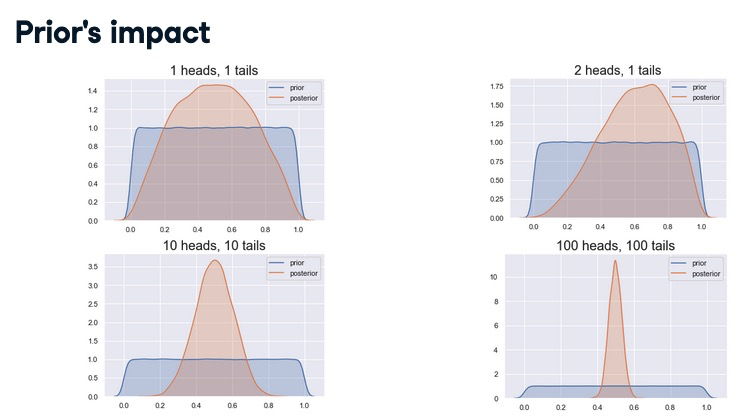

---
#### Prior distribution

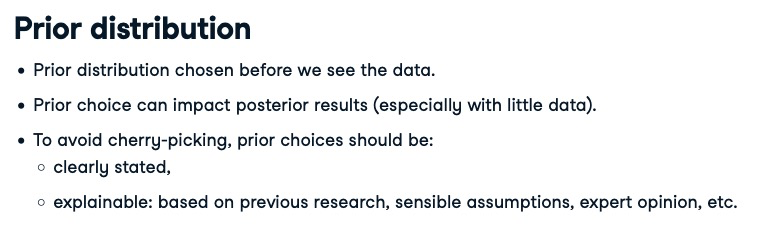

----
#### Choosing the right prior 

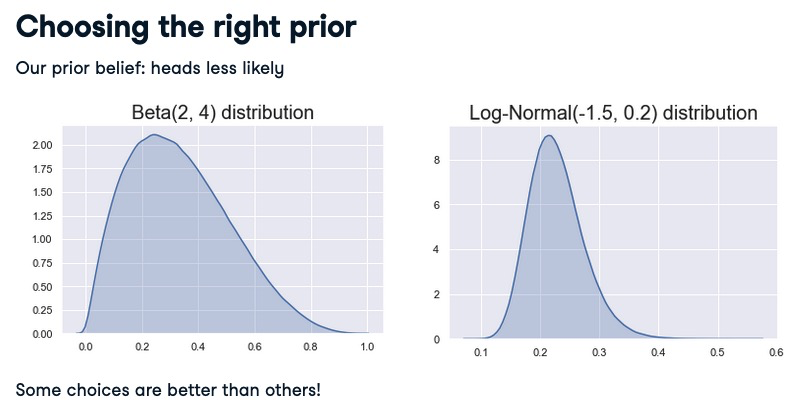

----
#### Conjugate priors 

Some priors, multiplied with specific likelihoods, yield posteriors of a known form. They are known as conjugate priors. 

For the coin tossing data, beta distribution is a conjugate prior. It means that if we choose a beta prior, then the posterior will be of known form, in this case also beta. How do we know this? Well, because it has been mathematically proved. 

[Wikipedia has a list of many conjugate priors for different use cases, for further reference.](https://en.wikipedia.org/wiki/Conjugate_prior) 

Since the posterior is a known distribution, we can easily sample draws from it using functions from numpy-dot-random, as you have done previously. Remember the get-heads-prob function? I implemented it using a beta prior and sampling 1000 draws from the posterior defined by the equation on the slide. Much easier than the grid approximation! 

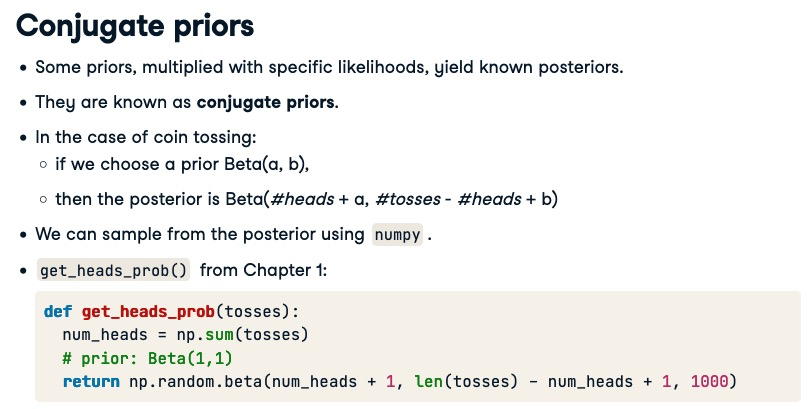

---
#### Two ways to get the posterior 

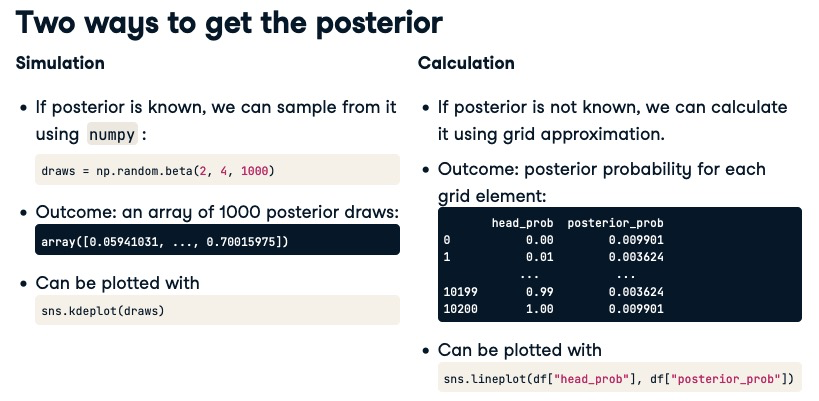

---
### Exercise: The truth of the prior 

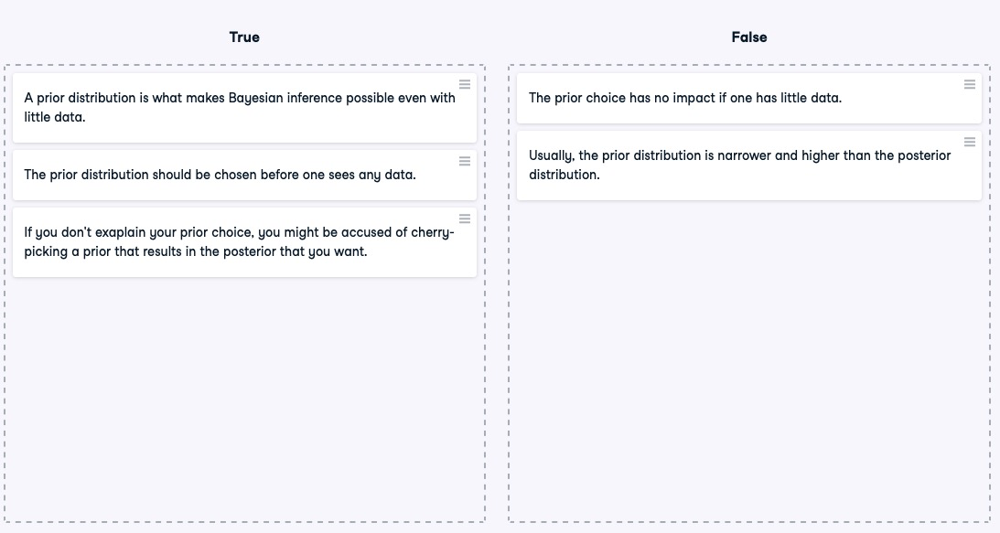

---
### Exercise: Simulating posterior draws 

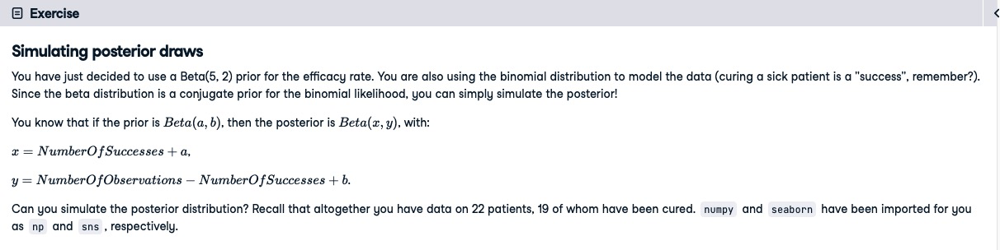

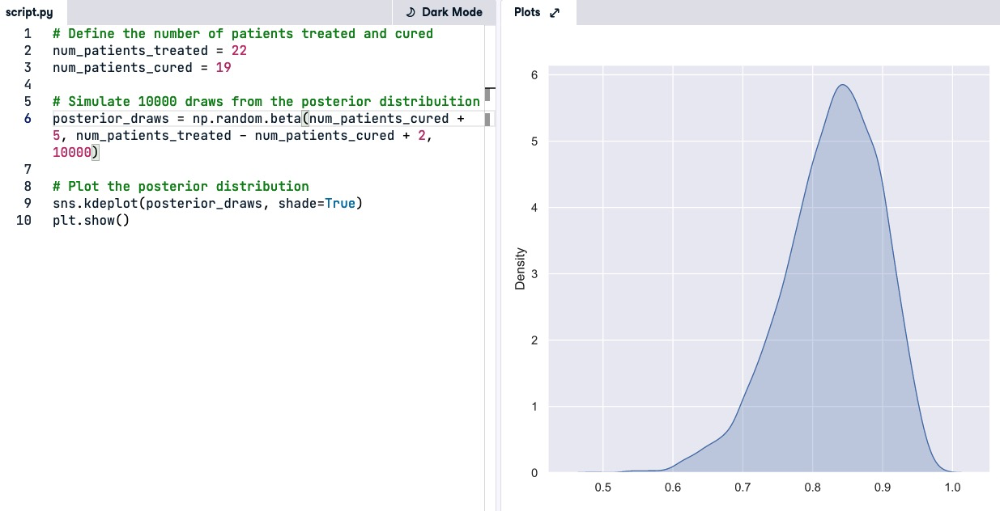

#### Take away:
Notice that the posterior distribuion has a slightly longer tail on the left-hand side, allowing for efficacy rates as small as 50%, even though in your data you observe 86% (19 out of 22). This is the impact of the prior: you learn not only from your own small data, but also from other countries' experience!

---
## Reporting Bayesian results 

#### The honest way 

The truly honest way of reporting Bayesian parameter estimates is to present the prior and the posterior of each parameter. Assuming you have the draws from the prior and posterior distributions in a numpy array, you can plot the two distributions with seaborn's kdeplot function. 

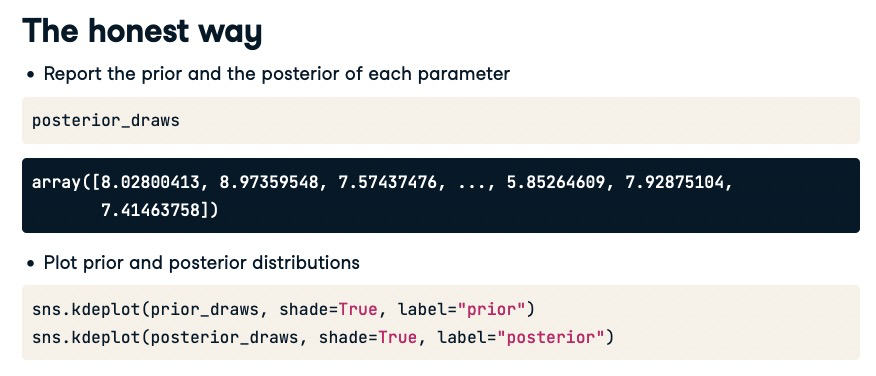

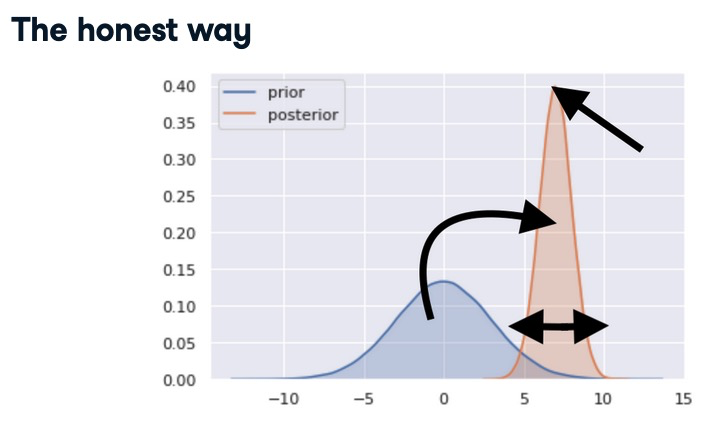

#### Bayesian point estimates 

No single number can fully convey the complete information contained in a distribution. Yet, sometimes such information compression is necessary and we need a single number called a point estimate. 

There are many different point estimates you can calculate. One is the expected value, or mean, of the posterior distribution, marked in red on the slide. 

You can also summarize the posterior distribution by its median, shown in orange. It is such a number that we are 50% sure the parameter's value is at least this. The mean and the median can be easily computed with the corresponding numpy functions. For a symmetric distribution like the one in the picture, they are almost the same, but this does not hold for all distributions. 

You can also calculate percentiles based on the posterior draws. The 75th percentile, computed with np-dot-percentile and marked in green, is such a value that 75% of the distribution mass is below it, which means we are 75% sure the parameter's value is at most this. 

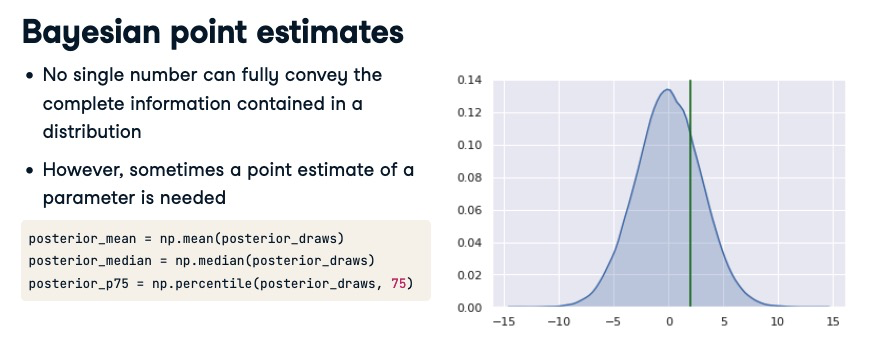

#### Credible intervals 

In addition to providing a point estimate, it is a good practice to provide a measure of uncertainty in the estimation. This can be achieved by computing a credible interval. A credible interval is such an interval that the probability that the parameter falls inside it is 90%, for instance. The wider the credible interval, the larger the range of values the parameter is likely to take, and hence, the greater the uncertainty in its estimate. Remember that in the Bayesian world, a parameter is a random variable, so we can talk about the probability it falls into some interval. This is in contrast to the frequentist world, where it is the interval (called a confidence interval) that is random while the parameter is a fixed value. They can only make probabilistic statements about the interval, not the parameter. It is a subtle but important distinction. 

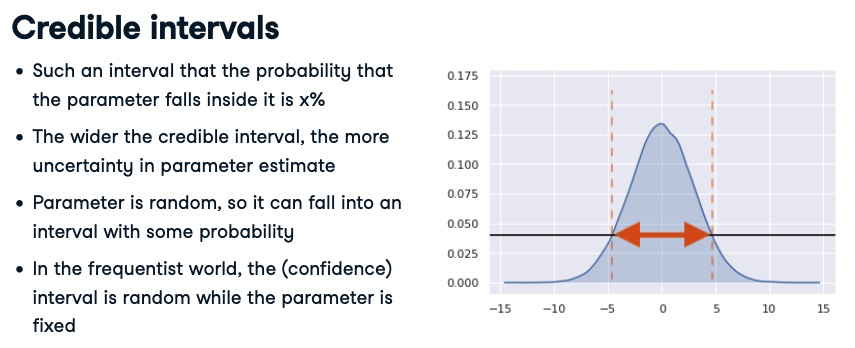

#### Highest Posterior Density (HPD)

One way to compute a credible interval is by Highest Posterior Density, or HPD. 

To understand how the HPD intervals are constructed, imagine a horizontal line hovering above a distribution. It starts descending until it intersects with the density plot. The two points at which the intersection occurs mark the ends of the interval. The line descends further, thus widening the interval, until the probability mass inside the interval reaches the desired value. To calculate it, we will use the hdi function from the arviz package. arviz is a package for exploratory analysis of Bayesian models. We can pass the posterior draws to hdi, setting the highest density interval probability to 0-point-9, that is 90%. As a result, we obtain the lower and upper bounds of the interval, which we interpret as follows: the probability that the parameter lies between negative 4-point-86 and 4-point-96 is 90%. 

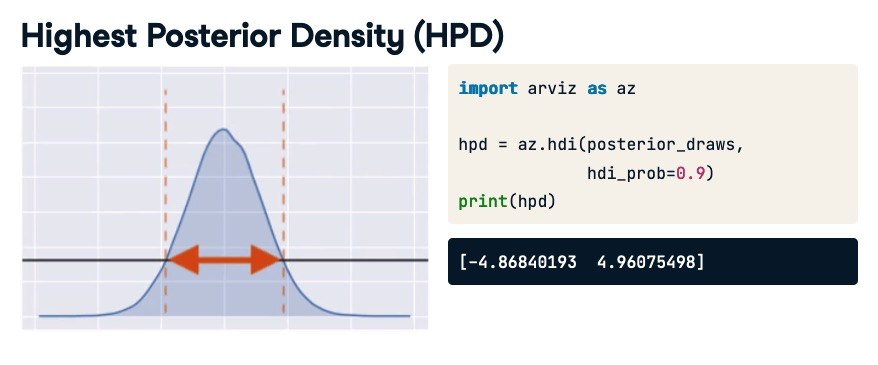

---
### Exercise: Point estimates 

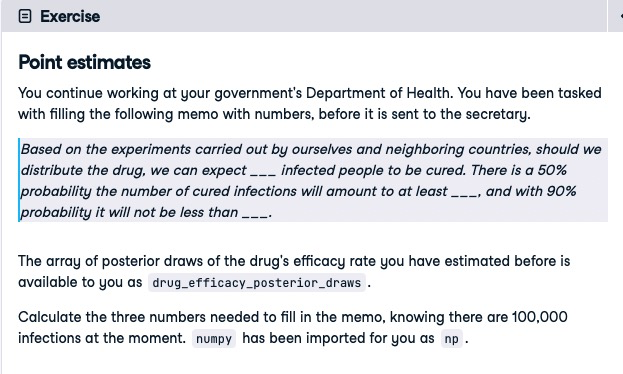

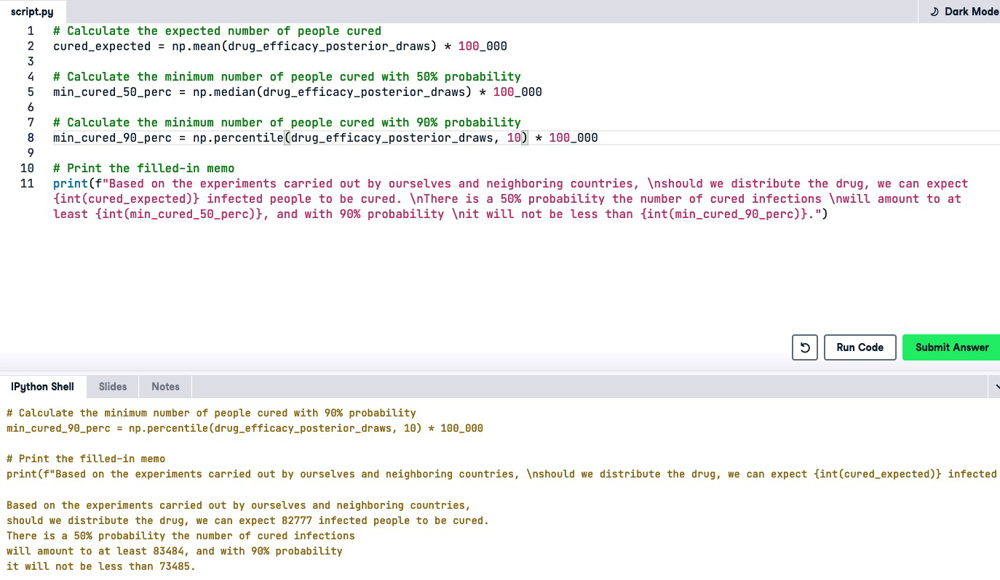

#### Take away:

Your memo compresses the posterior distribution of the drug's efficacy to a couple of useful numbers, certainly helping the secretary decide whether to buy the new drug. However, these numbers convey no information as to how uncertain the estimation is.

---
### Exercise: Highest Posterior Density credible intervals 

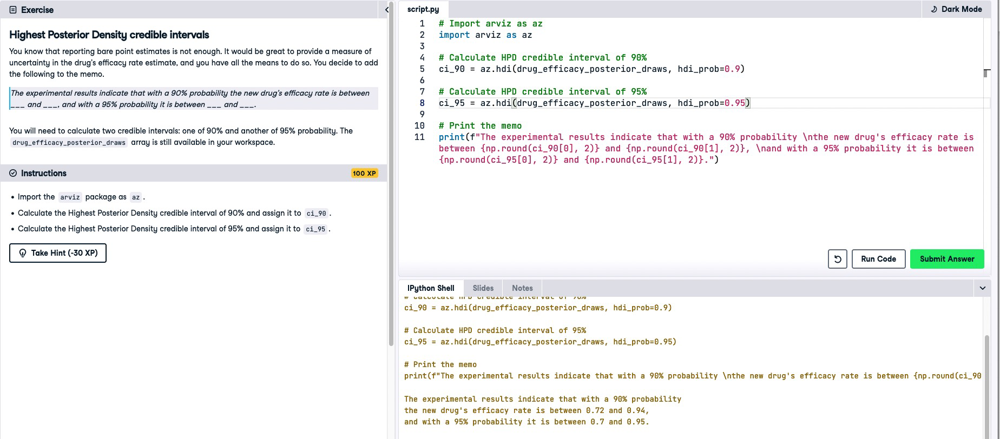

### Exercise: The meaning of credibility

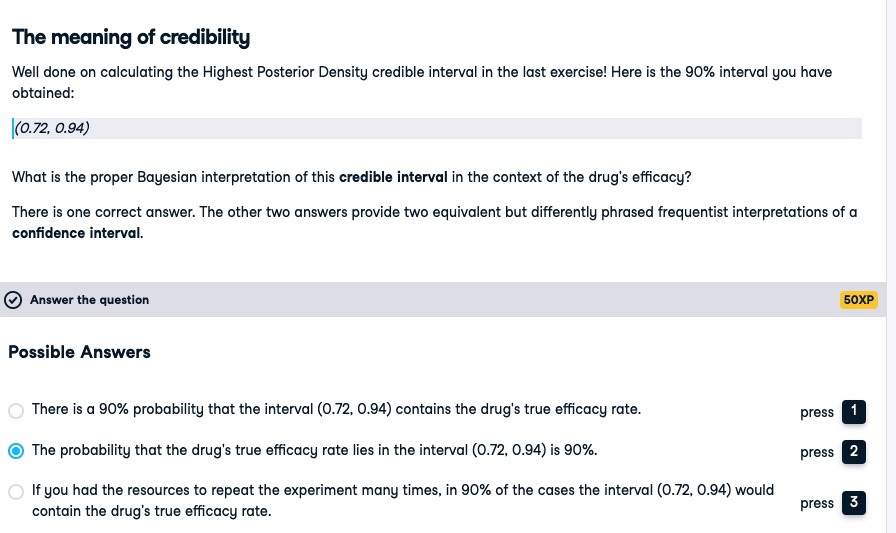

#### Take away:

That's the Bayesian interpretation of a credible interval. Since the drug's true efficacy rate is considered a random variable, we can make probabilistic statements about it, as in: "the probability that it takes a particular value or that it lies in a particular interval is X%". 

---
# 3. Bayesian inference 


---
## A/B testing 

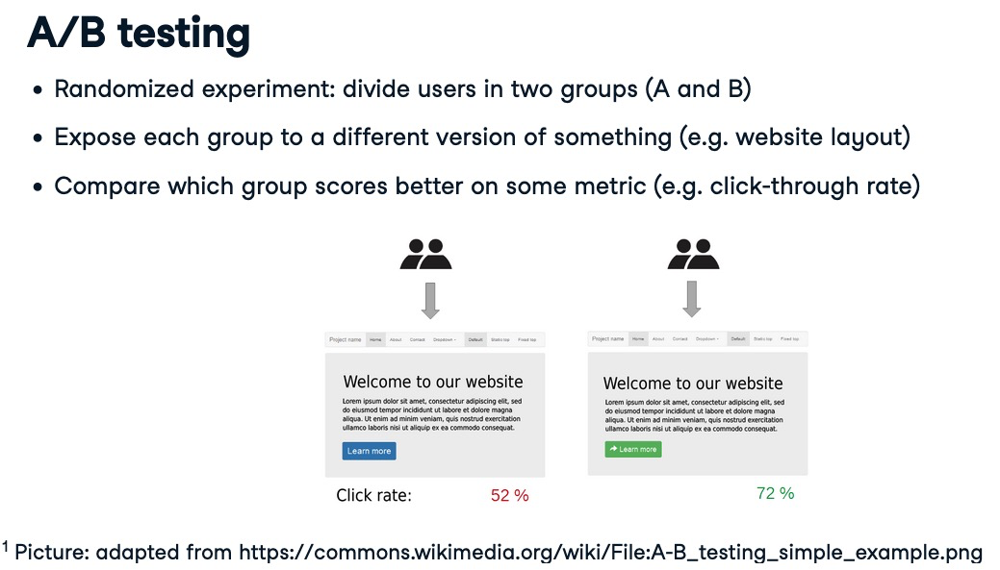

---
#### A/B testing: frequentist way

The typical, frequentist approach to A/B testing is based on a statistical procedure known as hypothesis testing. The main drawback of this approach is that we can only conclude which group is better, but not how much better it is. 

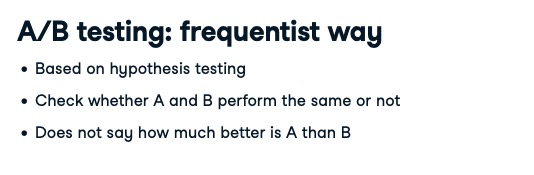

---
#### A/B testing: Bayesian way

Alternatively, the Bayesian approach allows us to calculate the posterior click-through rates for websites A and B, compare them directly, and calculate the probability that one is better than the other. 

We can also quantify how much better it is, and even estimate the expected loss in case we make a wrong decision and deploy the worse website version. 

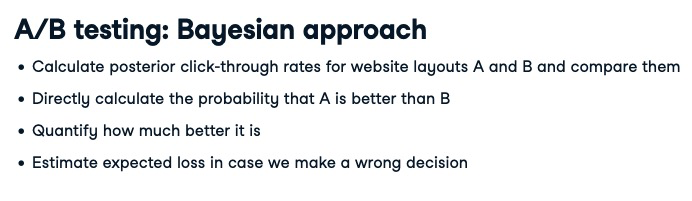

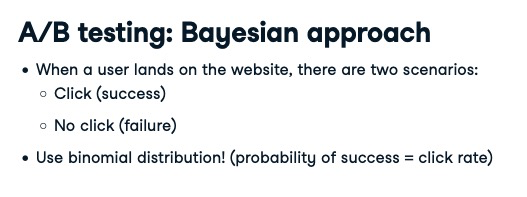

---
#### Simulate beta posterior 

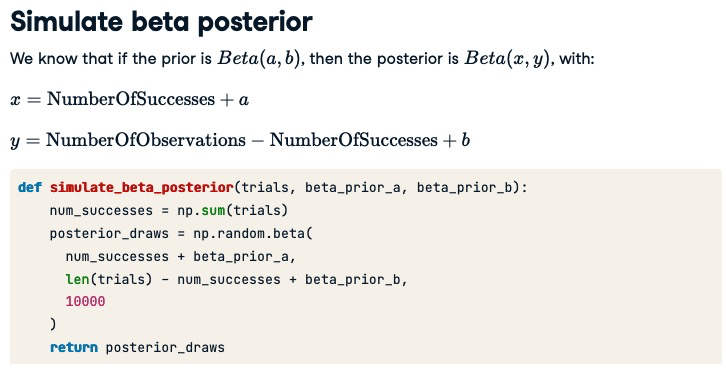

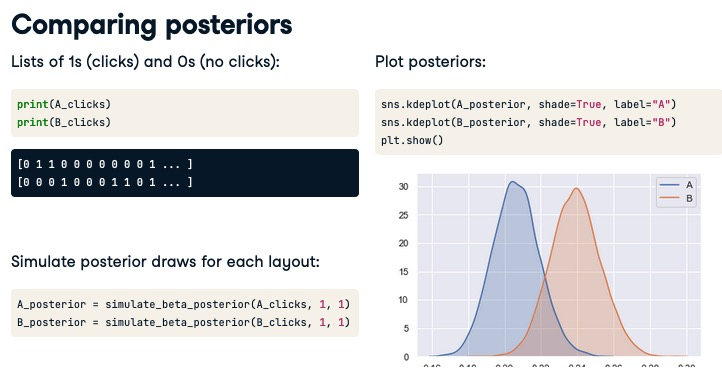

---
#### Comparing posteriors - diff between B and A

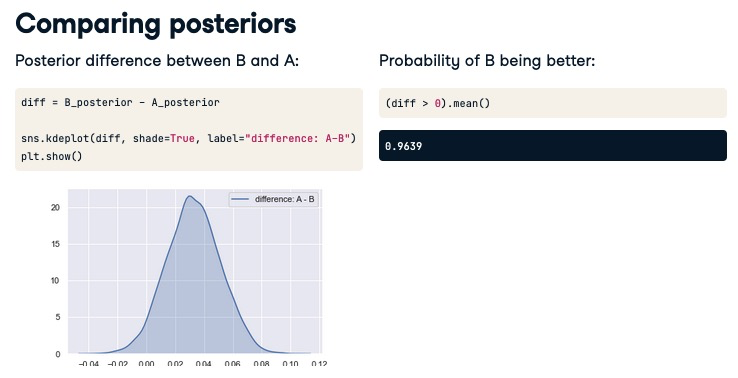

---
#### Expected loss 

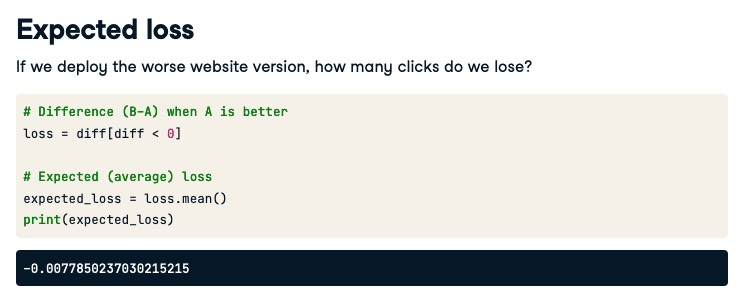

---
#### Ads data

In [13]:
print(ads)

                               user_id   product site_version  \
0     f500b9f27ac611426935de6f7a52b71f   clothes      desktop   
1     cb4347c030a063c63a555a354984562f  sneakers       mobile   
2     89cec38a654319548af585f4c1c76b51   clothes       mobile   
3     1d4ea406d45686bdbb49476576a1a985  sneakers       mobile   
4     d14b9468a1f9a405fa801a64920367fe   clothes       mobile   
...                                ...       ...          ...   
9995  7ca28ccde263a675d7ab7060e9ed0eca   clothes       mobile   
9996  7e2ec2631332c6c4527a1b78c7ede789   clothes       mobile   
9997  3b828da744e5785f1e67b5df3fda5571   clothes       mobile   
9998  6cce0527245bcc8519d698af2224c04a   clothes       mobile   
9999  8cf87a02f96327a1a8a93814f34d0d0c  sneakers       mobile   

                     time  banner_clicked  
0     2019-01-28 16:47:08               0  
1     2019-03-31 17:34:59               0  
2     2019-02-06 09:22:50               0  
3     2019-05-23 08:07:07               0  

---
### Exercise: Simulate beta posterior

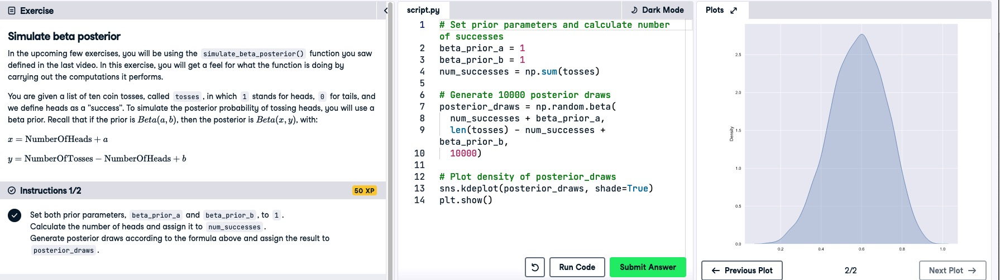

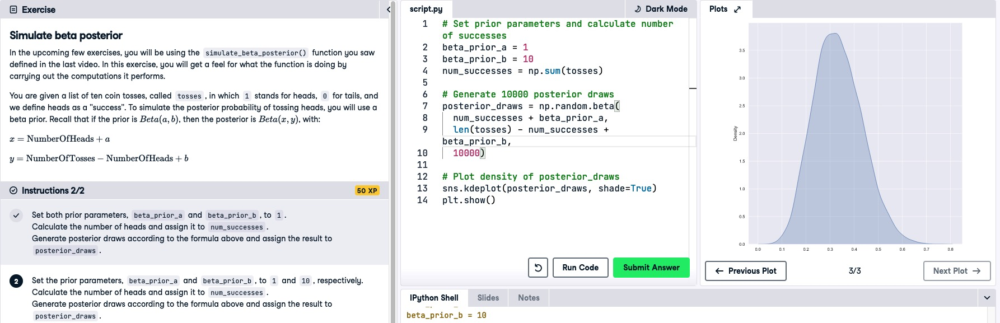

#### Take away:

Now you see what simulate_beta_posterior() is doing: based on the binomial data and the prior, it samples posterior draws. Notice how using the Beta(1, 10) prior shifts the posterior to the left compared to Beta(1, 1). This effect is quite strong, as there is little data: just 10 coin flips. 

---
### Exercise: Posterior click rates 

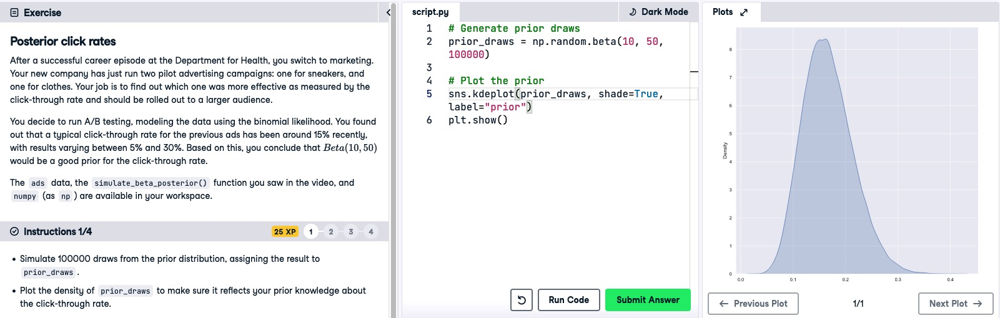

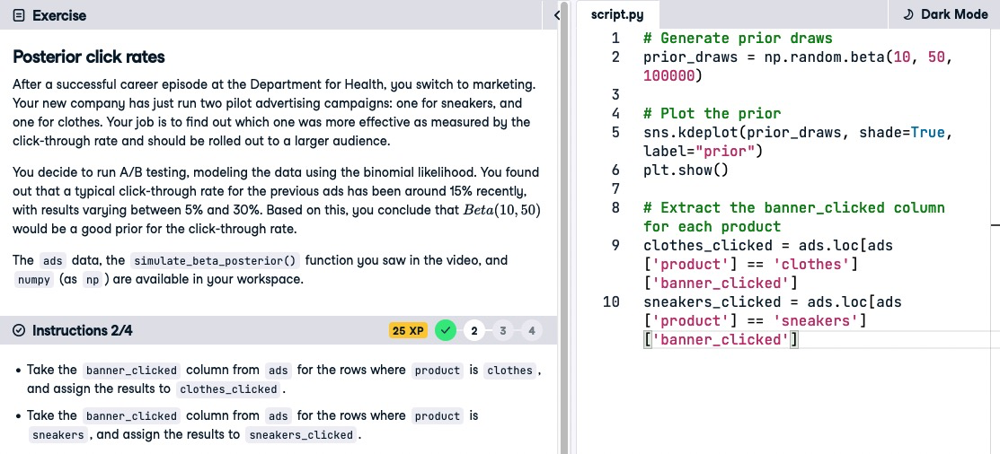

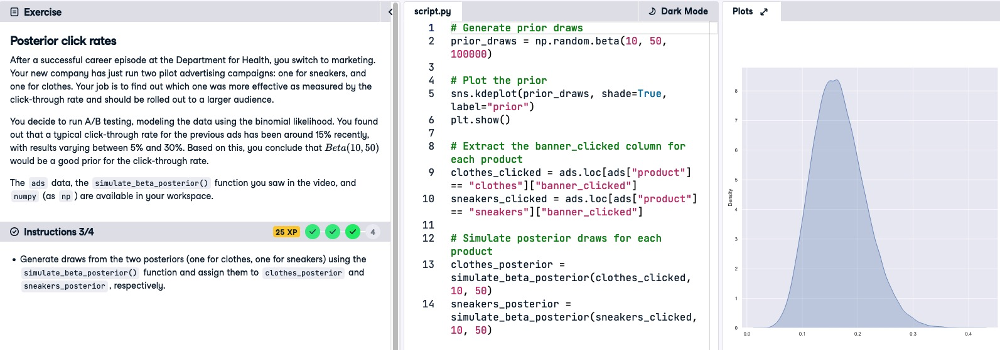

<span style='color:red'>Re-type the above codes here</span>

---
### Exercise: A or B, and how sure are we?

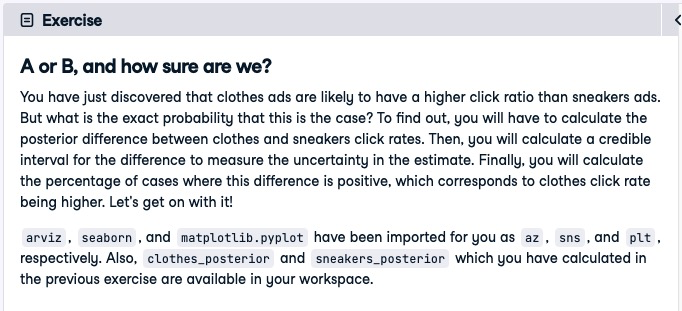

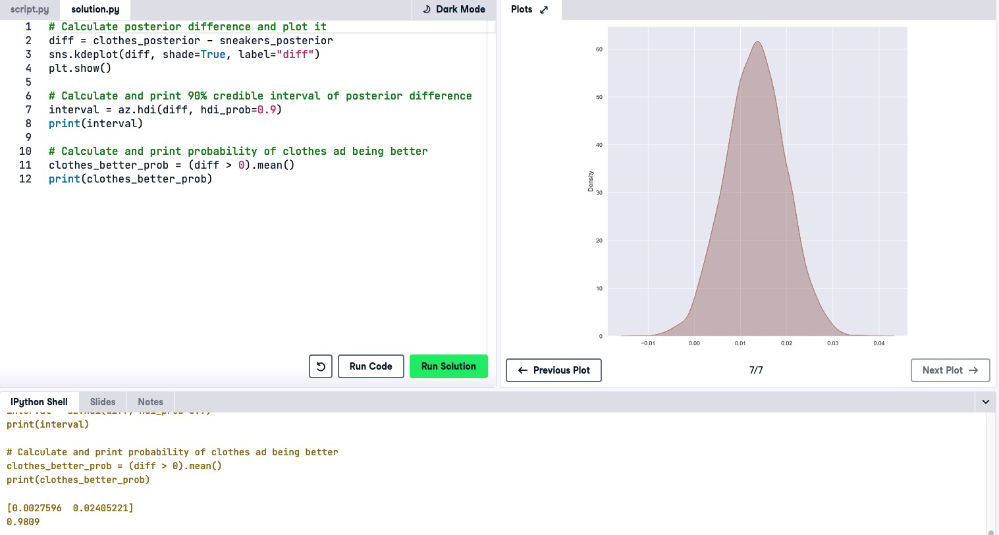

#### Take away:

Take a look at the posterior density plot of the difference in click rates: it is very likely positive, indicating that clothes are likely better. The credible interaval indicates that with 90% probability, the clothes ads click rate is up to 2.4 percentage points higher than the one for sneakers. Finally, the probability that the clothes click rate is higher is 98%. Great! But there is a 2% chance that actually sneakers ads are better!

---
## Decision analysis 

Most often, decision-makers don't care about the parameters of statistical models. What they do care about is maximizing profit, reducing costs, or saving lives. Consider the efficacy of the drug you have been estimating previously. Say the posterior mean of the efficacy rate is 99%. It's the most effective drug according to the model. However, it is also expensive and with limited budget the government cannot afford enough doses. 

Now, consider another drug, with slightly lower efficacy, but much cheaper. This other drug might allow the government to save many more lives! This is the role of decision analysis: **to translate the parameters of statistical models into relevant metrics in order to inform decision-making.**

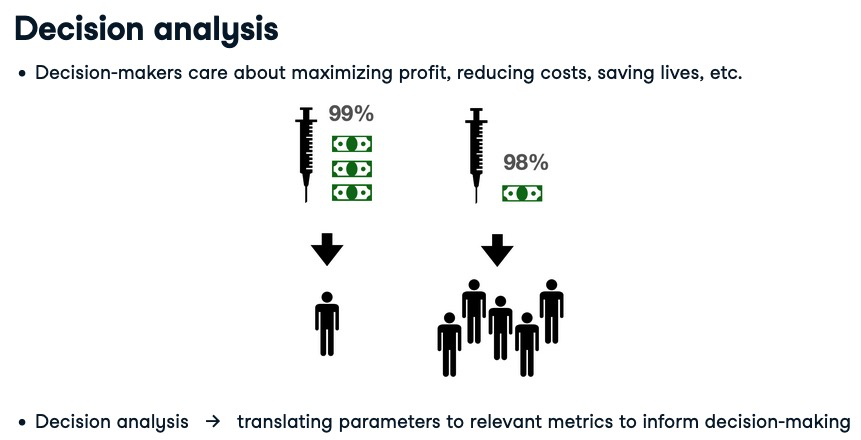

---
#### From posteriors to decisions 

Businesses and government agencies alike constantly operate under uncertainty. To make strategic decisions, it helps to know the probabilities of different scenarios playing out. Bayesian methods allow us to translate posterior distributions of the parameters that capture this uncertainty into relevant metrics very easily. Imagine you have just sampled from the posterior distribution of a model parameter, say: a click-through rate. Your company, however, is not very interested in the rate itself, but rather in the revenue the clicks generate. 

You can multiply each draw from the posterior with the number of impressions, that is the number of people to whom the ad will be displayed. This way, you get a distribution of the number of clicks instead of the click-through rate. 

You can then multiply the result with the expected revenue per click, a metric the company already knows. 

As a result, you obtain a posterior distribution of the revenue generated by the clicks. Notice how capturing uncertainty via probability distributions has been translated from model parameters to a business-relevant metric! Based on the outcome, the decision-makers know what revenue to expect, as well as what's the worst-case scenario and how probable it is, and they can decide accordingly. 

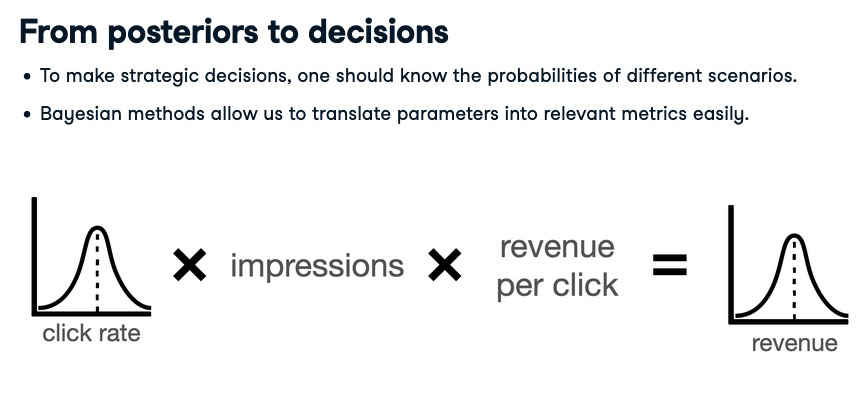

---
#### Posterior revenue

Let's see this in action. Say you have simulated posterior draws of the click rates for two ads: A and B. You are going to display the ads to 1000 users. The expected revenue from one click, however, is different for each ad, as they advertise different products. For ad A, it's $3-point-6 and for ad B it's $3. To get the distribution of the number of clicks for both ads, you can multiply the posterior with the number of impressions. Then, multiply the outcome with the revenue per click to get the distribution of the total revenue. 

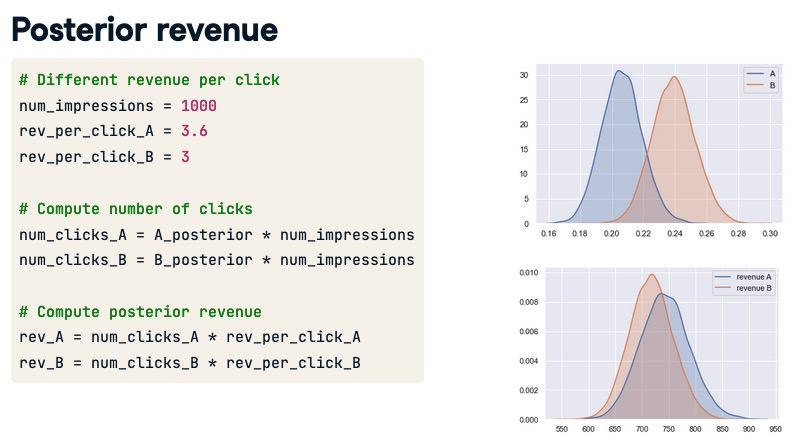

---
#### Forest plot 

So far, we have been plotting multiple density plots together using seaborn. This is not very convenient and gets messy with more plots. The solution is to use a `forest plot` instead. It's included in `pymc3`, the same package you have already used for calculating credible intervals, and you will get more familiar with it in the next chapter. The only thing to do is to create a dictionary with the posterior draws. Then, we can call the pm-dot-forestplot function on this dictionary. Each density is represented as a line. 

**The bolder line in the middle of each density denotes the interquartile range, while the thin whiskers show the HDI credible interval of 94% by default.** 

One can easily adjust it by passing the `hdi_prob` argument with the desired HDI value: here, 99%. 

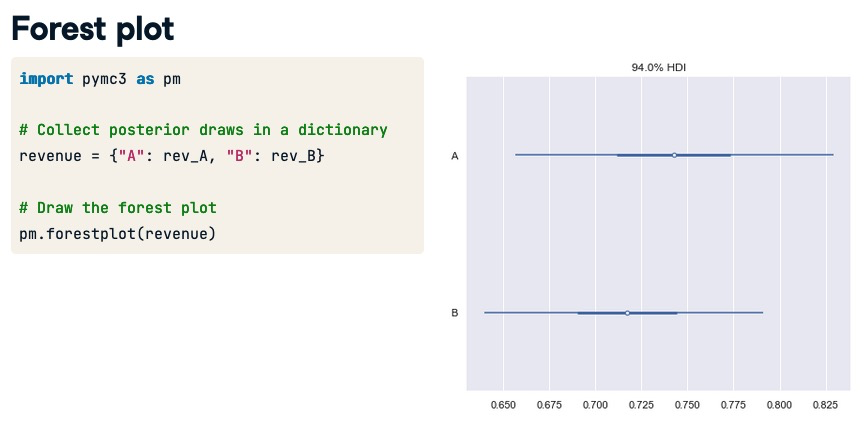

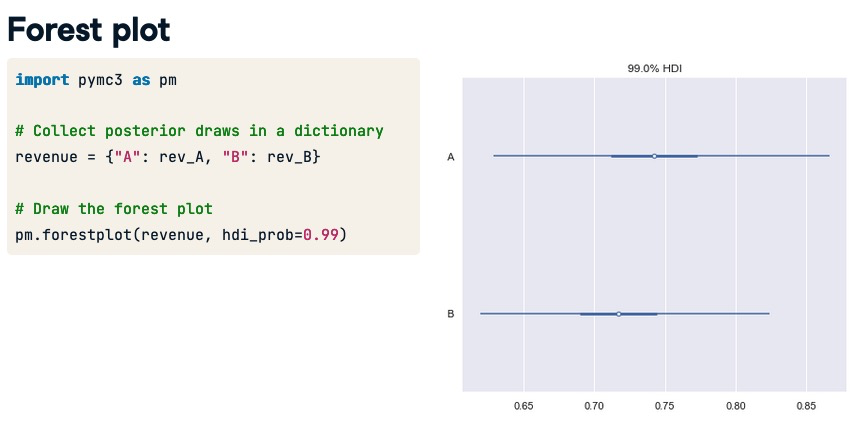

---
### Exercise: Decision analysis - cost 

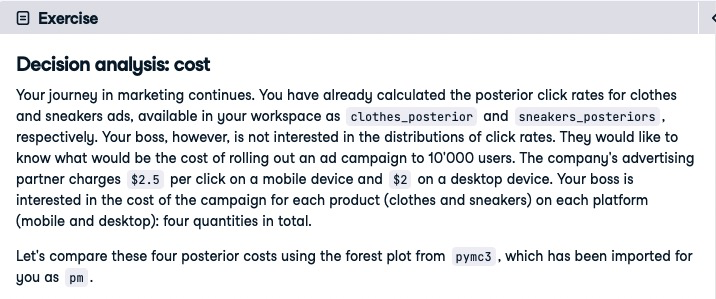

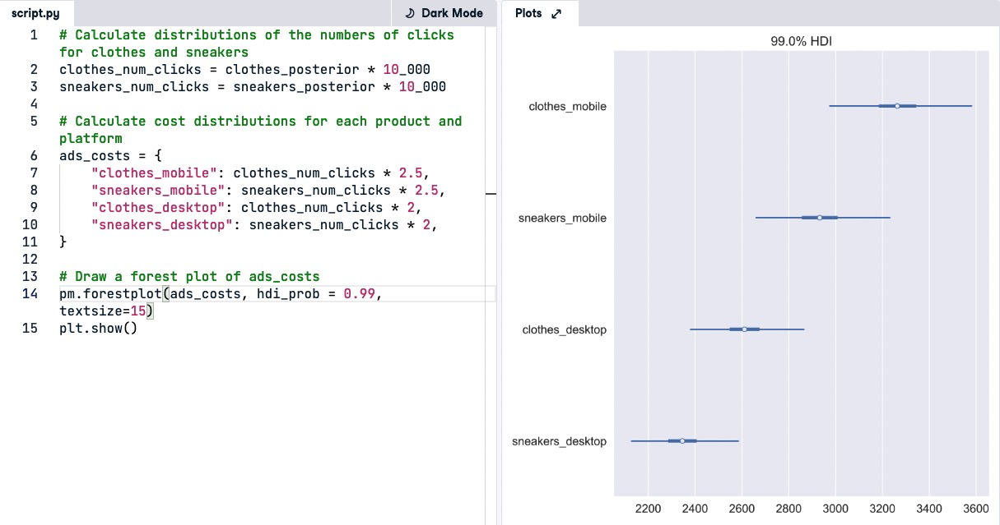

#### Take-away:

The ends of the whiskers mark the 99% credible interval, so there is a 1% chance the cost will fall outside of it. It's very, very unlikely, but there is a slim chance that the clothes-mobile cost will turn out lower. It's important to stay cautious when communicating possible scenarios -- that's the thing with probability, it's rarely the case that something is 'completely impossible'!

---
### Exercise: Decision analysis - profit

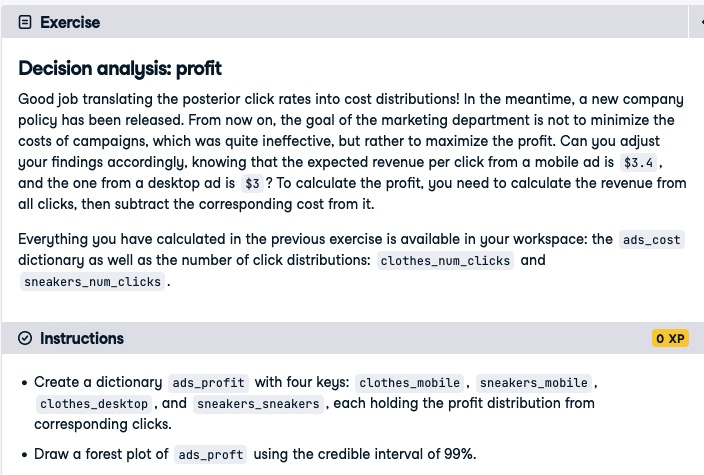

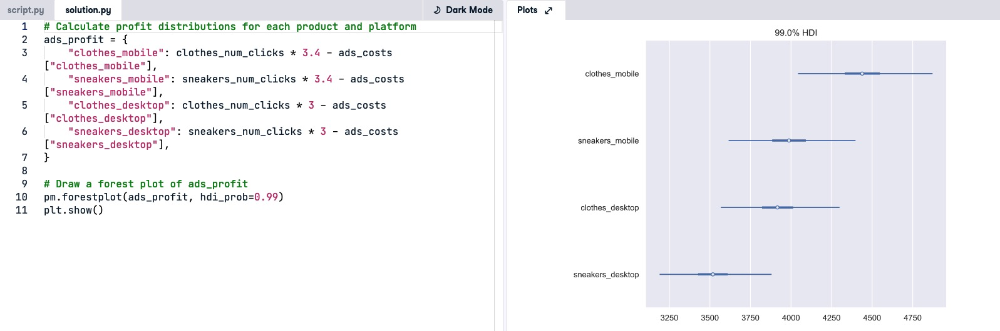

#### Take away:

Notice how shifting focus from costs to profit has changed the optimal decision. The sneakers-desktop campaign which minimizes the cost is not the best choice when you care about the profit.

---
## Regression and forecasting 

---
#### Linear regression 

In a linear regression model we are modeling the response, y, as a linear combination of some predictors, x. We can model sales as a function of marketing spending, for instance. The intercept, Beta-zero, is sales level without any spending, and beta-one denotes the impact of marketing spending on sales. 

`In the frequentist world`, betas are single numbers and we cannot find values for them that would make the equation always hold. Consequently, we add an error term denoted by the Greek letter epsilon and say that this error term has a normal distribution with mean zero and some standard deviation, sigma. 

`In the Bayesian world`, we treat the response as a random variable, and assume that it has a normal distribution with the mean defined by the regression equation and some standard deviation. Let's take a closer look at the normal distribution then! 

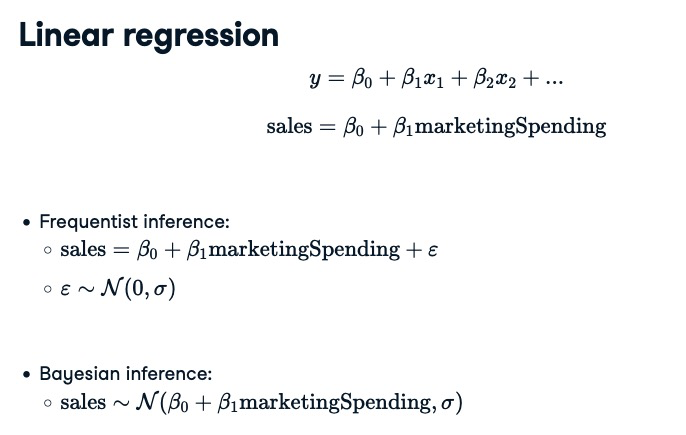

---
#### Normal distribution 

Let's sample draws from the normal distribution and plot them to see how it looks like. To do this, we use the np-dot-random-dot-normal function, with two parameters to set: the mean and the standard deviation, which we set to 0 and 1 respectively. The normal distribution density, also called a bell curve, is symmetric around its mean and almost all the probability mass is within its mean plus/minus 3 standard deviations. 

By setting the mean to 3, the distribution shifts and centers around 3. 

By increasing the standard deviation to 3 instead, the distribution becomes wider and shorter. 

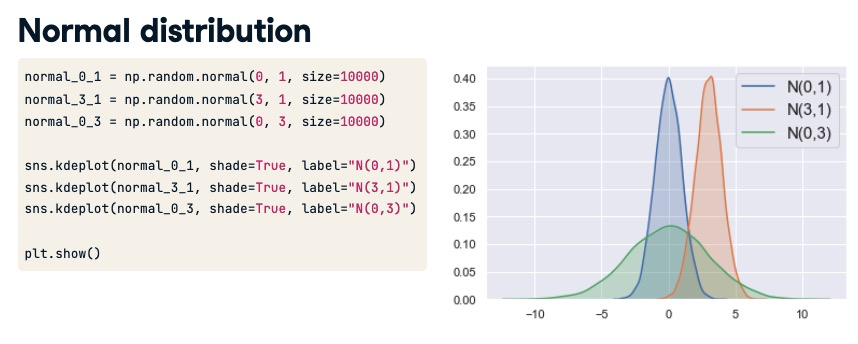

---
#### Bayesian regression model definition 

Let's now define our Bayesian regression model. We have already said that sales are normally distributed but a full model specification also requires the priors for all 3 parameters: the intercept, the spending impact, and the standard deviation. 

We could use many priors, but let's use normal ones for the betas. 
Assume sales and spendings are in thousands of dollars. First, we expect $5000 sales without any marketing. Also, we expect $2000 increase in sales from each $1000 increase in spending, but are not certain, so we make the prior for beta-1 wider by setting its standard deviation to 10. 

We don't have any feelings about the regression standard deviation parameter, sigma, so we use the uniform prior. 

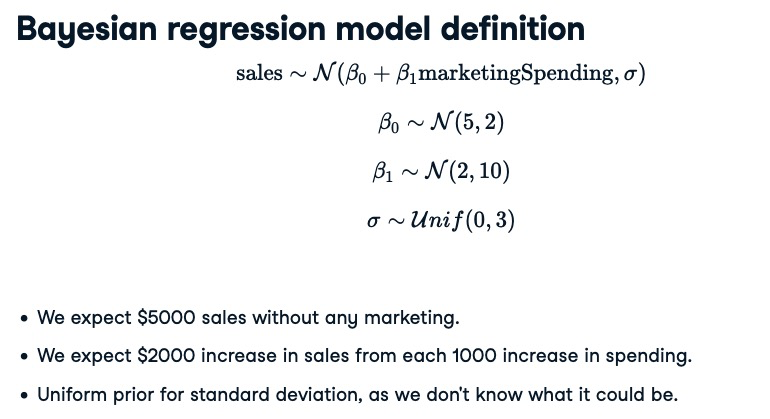

---
#### Estimating regression parameters 

How to get the posteriors? 

`Grid approximation` could work, but is `impractical` for more than one parameter. 

We could choose `conjugate priors` so that we can simulate from the posterior, but the conjugate priors for linear regression are not very intuitive. And we want our priors! 

Fortunately, we can simulate from the posterior even with non-conjugate priors using **Markov Chain Monte Carlo**, a technique which will be covered in the next chapter. For now, let's assume we have sampled the parameter draws and focus on working with them. 

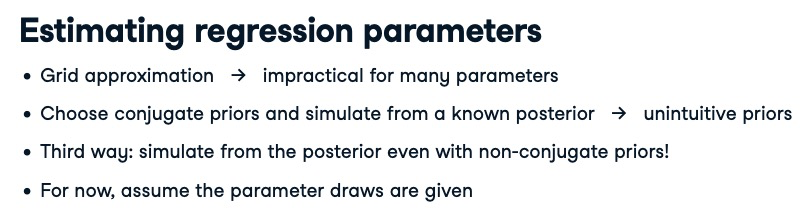

---
#### Plot posterior 

A good practice is to analyze the posterior draws visually before we make any predictions with the model. 

Let's introduce another function from `pymc3` called `plot_posterior`. You pass it the draws and set the credible interval, and it plots the density, marking its mean and the interval. 

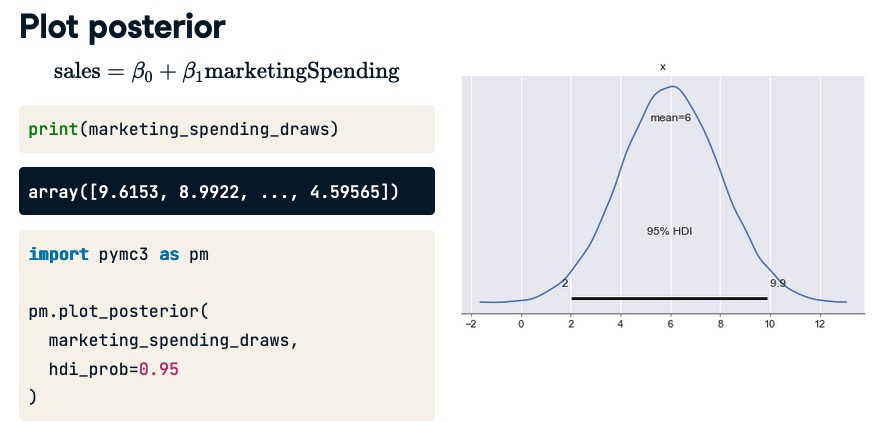

---
#### Posterior draws analysis 

With many parameters, it's convenient to look at all of them at once. Once you have all three parameters sampled, you can collect them in a DataFrame and use the dot-describe method, which allows us to inspect the descriptive statistics of the posterior draws. 

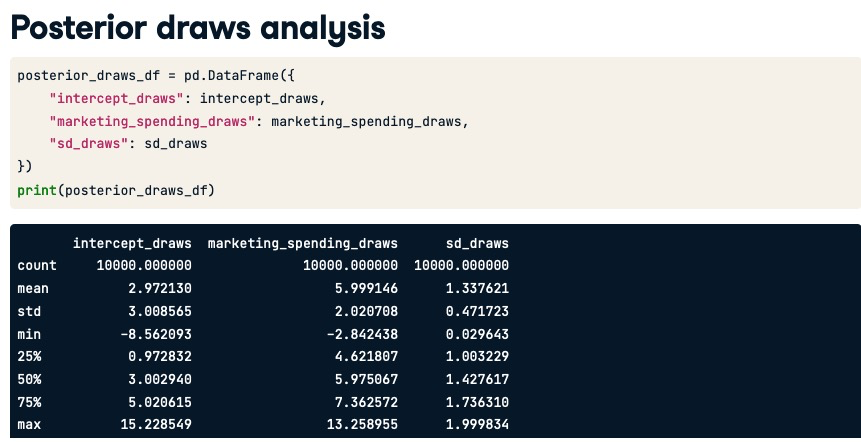

---
#### Predictive distribution 

Time to make predictions. 

How much sales can we expect if we spend $1000 on marketing? 

To calculate it, we first get the point estimates of the parameters, in this case the posterior mean. Then, we calculate the mean of the sales distribution according to the regression formula, setting 1000 as the marketing spending. Finally, we simulate from the predictive distribution to get the sales forecast. 

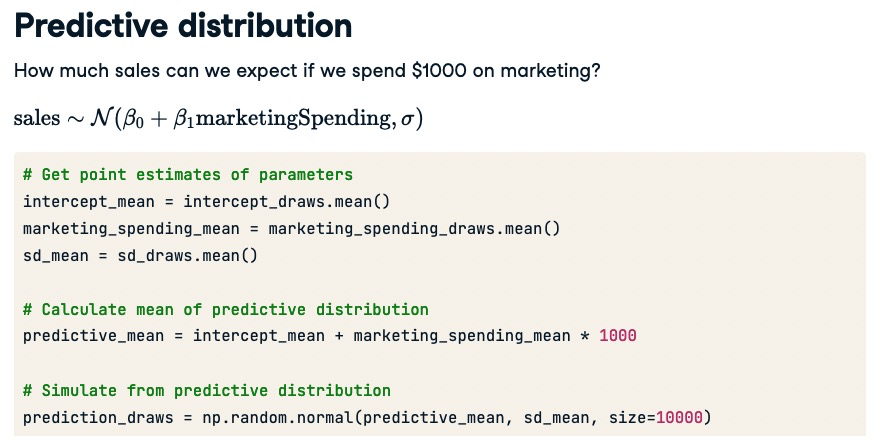

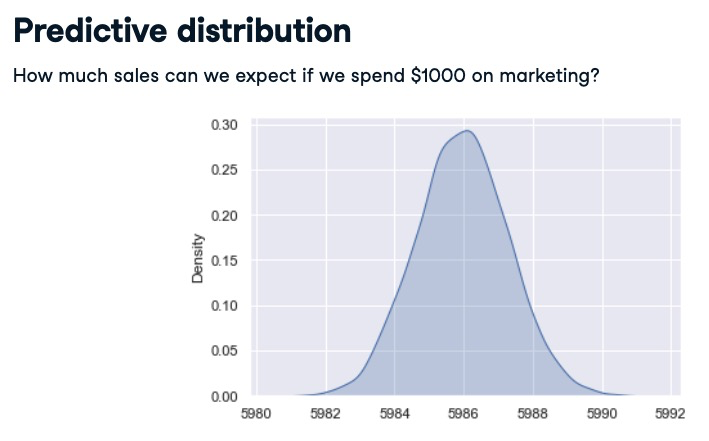

---
### Exercise: Analyzing regression parameters 

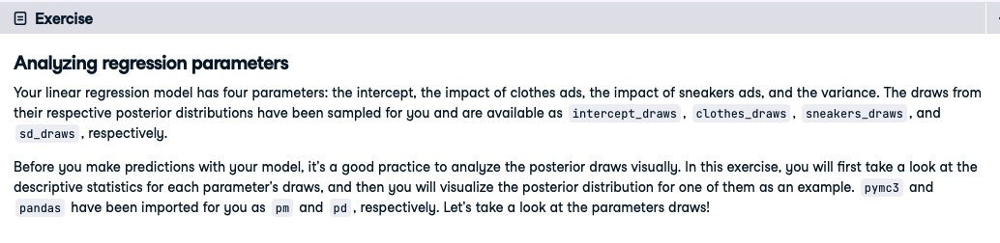

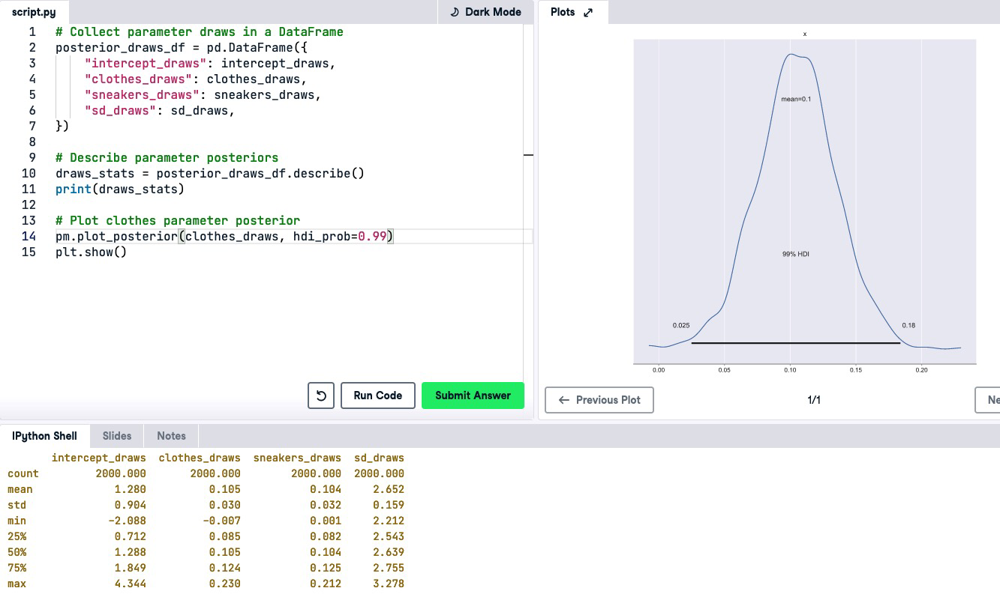

#### Take away:
Take a look at the output in the console and at the plot. The impact parameters of both clothes and sneakers look okay: they are positive, most likely around 0.1, indicating 1 additional click from 10 ad impressions, which makes sense. Let's now use the model to make predictions!

---
### Exercise: Predictive distribution 

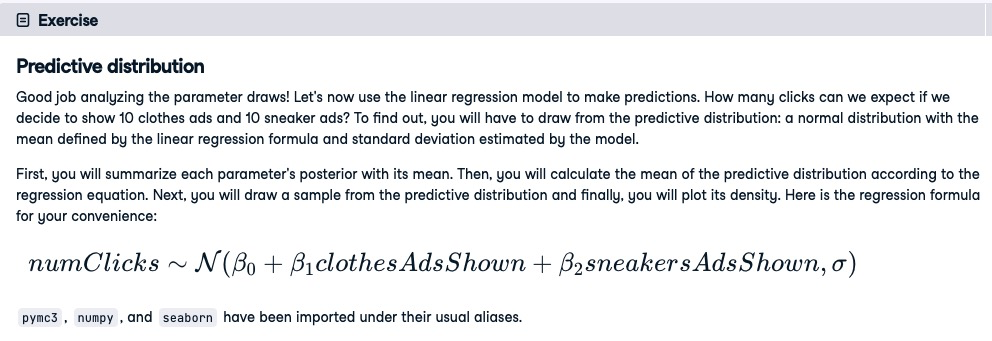

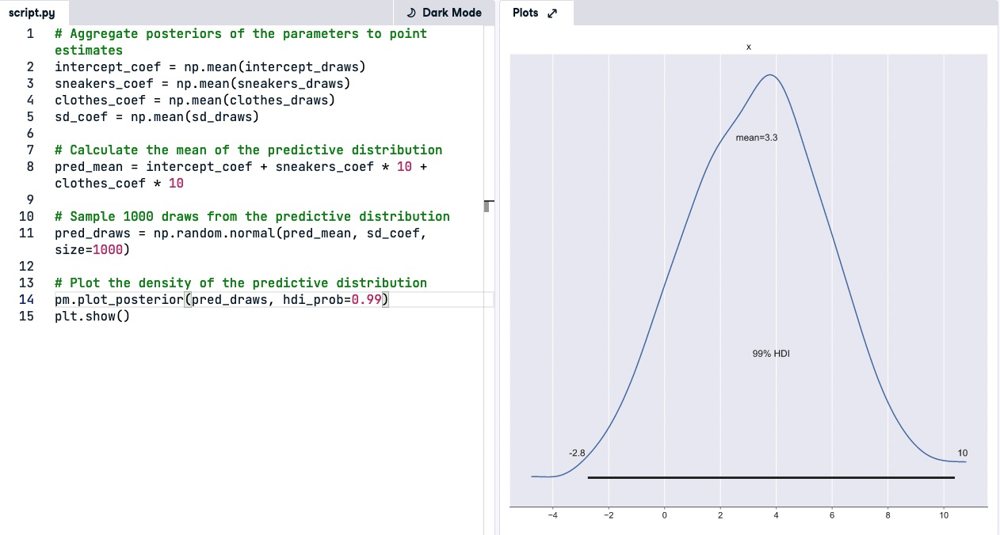

#### Take away:

It looks like you can expect more or less three or four clicks if you show 10 clothes and 10 sneaker ads. 

---
# 4. Bayesian linear regression with pyMC3

---
## Markov Chain Monte Carlo and model fitting 

---
#### Bayesian data analysis in production 

We've seen two ways of sampling posterior draws: `grid approximation` and choosing `conjugate priors` and sampling from a known posterior, each with their own limitations. 

In practice, another method is usually used: `Markov Chain Monte Carlo`, or MCMC, which allows us to sample even from unknown posteriors. 

**All three methods yield the same results, but MCMC is the most flexible - it works with any model and any priors.** 

Let's look at its two building blocks: Monte Carlo and Markov Chains. 

---
#### Monte Carlo

Monte Carlo is a way to approximate a quantity by generating random numbers. 

Consider a circle with radius 5. From the formula, we know its area to be 78.5. 

But how might we approximate the area without the formula? To start, we can define a 10 x 10 square on the circle. 

Then, we generate random points inside the square. The more points, the more precise the approximation. Let's use only 25. 19 out of 25 points, or 76%, fell inside the circle, meaning the circle's area is roughly 76% of the square's area, or: 76. Not bad using random numbers! 

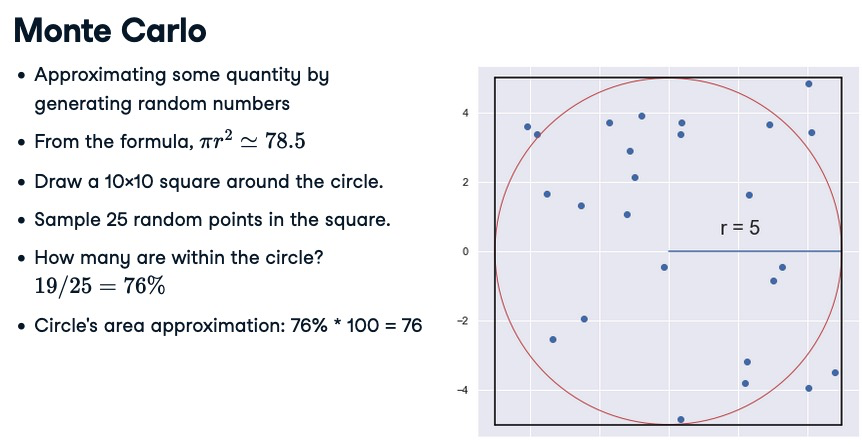

---
#### Markov Chains 

They are models of a sequence of states, between which one transitions with given probabilities. 

Imagine a bear that only hunts, eats and sleeps. The table shows the probabilities of transitioning between these three states. From the first row we see that if the bear is hunting now, there is a 10% probability it will hunt or sleep next, and an 80% probability it will eat. 

Some Markov Chains have a property that, after transitioning between states many times, they will reach a so-called steady state. This means that no matter where the bear started, the probabilities for it to be in particular states in a distant future are the same. 

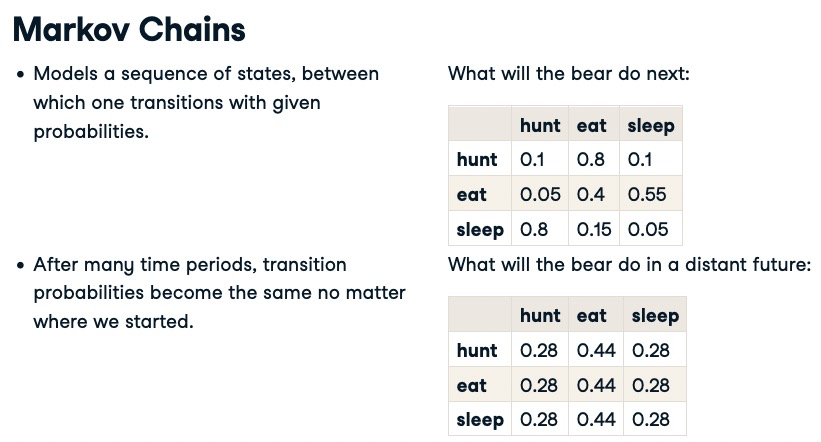

---
#### Markov Chain Monte Carlo

There are many MCMC samplers, but all work in a similar fashion. To get posterior draws for a parameter, we start by generating a random point.

Then another one, close to the first - that's the `Monte Carlo` part, random generation. 

Then, we check how well this new point explains our data, or: what's the likelihood with this value of the parameter. Then, we either accept or reject this new point. The better it explains the data, the higher the probability that we accept it. 

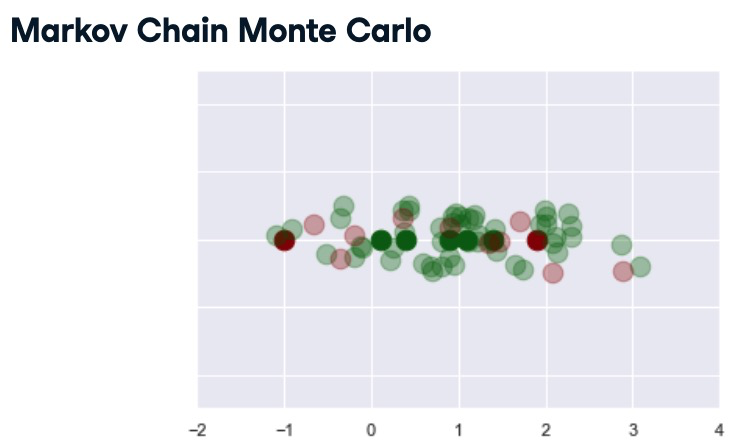

Eventually we have many accepted points. This generates a `Markov Chain`, and the probabilities of sampling specific values converge to the `steady state`, which is our `posterior distribution`. Finally, we discard some number of first draws, called `burn-in`, sampled before the Markov Chain has converged, since they are simply random. The remaining ones are our posterior draws. 

---
#### Aggregated ads data

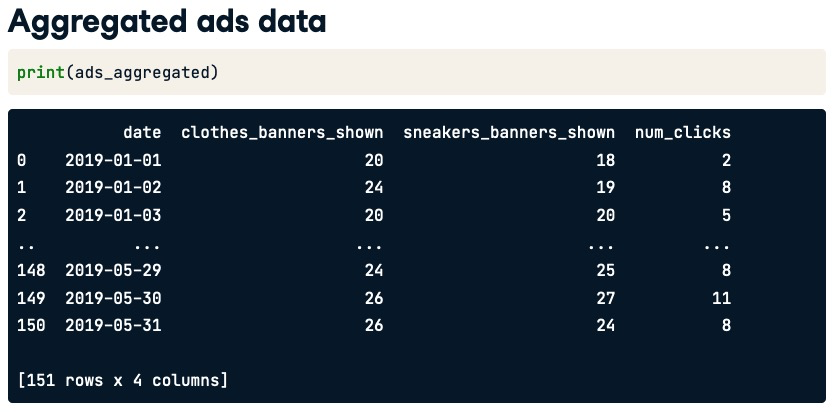

We want to predict `num_clicks` with a regression model using `clothes_banners_shown` and `sneakers_banners_shown`. 

---
#### Linear regression with pyMC3

We start by defining the regression formula, consisting of the response, a tilde sign, and the predictors separated with pluses. 

We open the with statement with `pymc3.model` instance as the model. 

Inside it, we define the model by calling `pm.glm.from_formula` with the formula and the data passed as arguments. 

`GLM` stands for `generalized linear model`, a class of models that includes linear regression. 

We could define the priors and the likelihood here, but the defaults are good for linear regression. 

We can print the model to see the priors for the parameters, and at the bottom, the normal likelihood for our target variable. 

Finally, we call `pm.sample` to generate 1000 `valid draws`, and 500 `burn-in draws`, set by the tune parameter. 

This output is conventionally called a `trace`. 

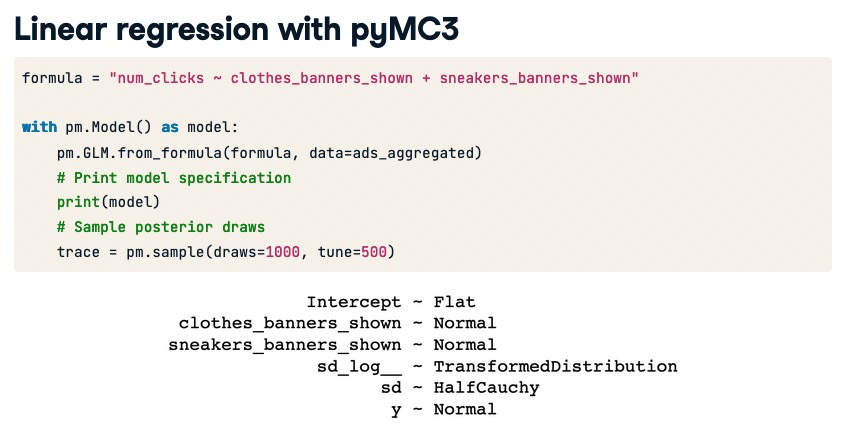

In [14]:
# # AttributeError: partially initialized module 'theano' has no attribute 'compile' (most likely due to a circular import)

# import pymc3 as pm

# formula = 'num_clicks ~ clothes_banners_shown + sneakers_banners_shown'

# with pm.Model() as model:
#     pm.GLM.from_formula(formula, data=ads_aggregated)
    
#     # Print model specification 
#     print(model)
    
#     # Sample posterior draws
#     trace = pm.sample(draws=1000, tune=500)

---
### Exercise: MCMC

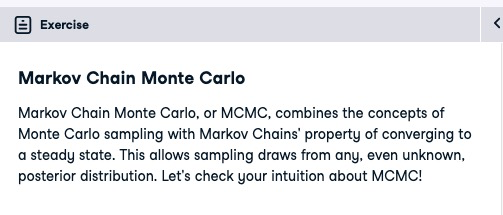

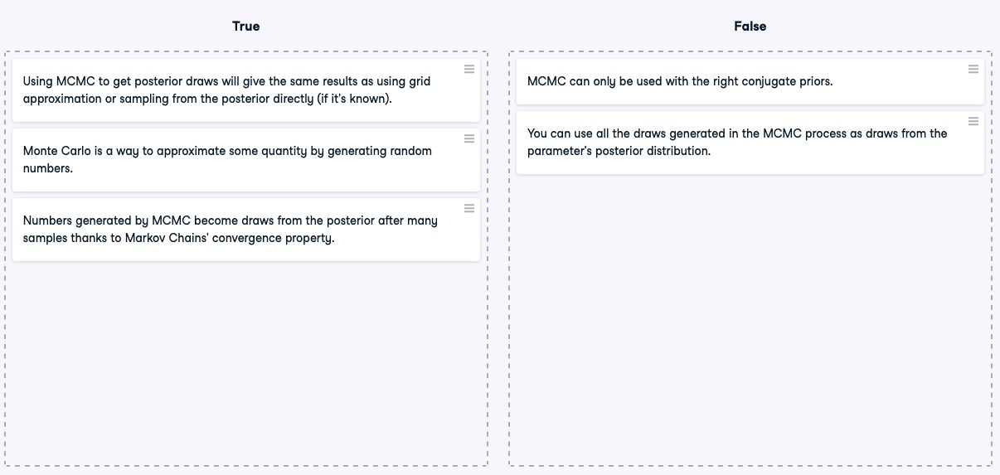

---
### Exercise: Sampling posterior draws 

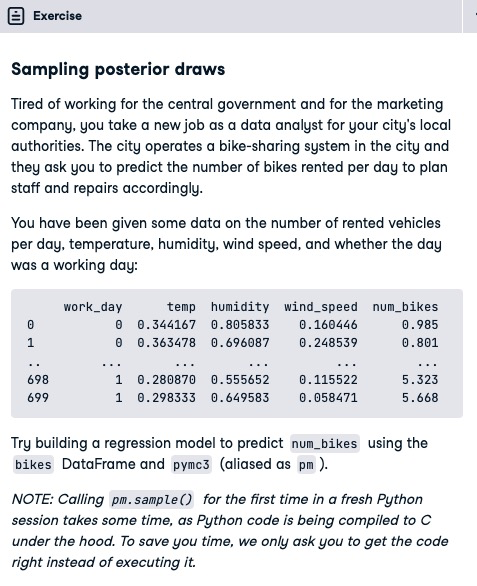

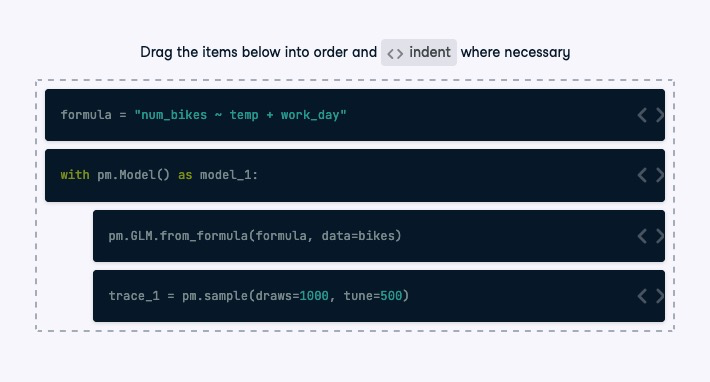

---
## Interpreting results and comparing models 

---
#### Running the model revisited 

Here is the model from before. 

Using `pm.sample`, we specified `1000 valid posterior draws` and before them, `500 burn-in draws` were sampled and discarded. 

We didn't set the chains parameter, which defaults to the number of cores of one's machine. Mine has 4, so chains was set to 4. The number of chains is the number of independent repetitions of the sampling process. `It's generally recommended to have more than 1 chain in case some of them don't converge.` 

We have 4 parameters in the model: the intercept, two impact parameters, and the standard deviation. 

For each of them, we have 1000 draws per chain, and so we get 4000 posterior draws in total. 

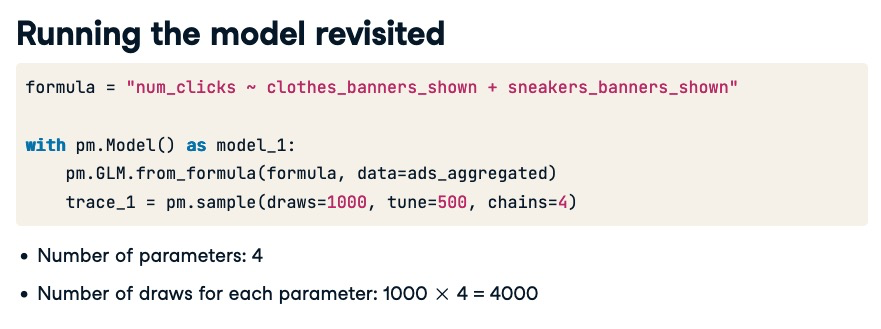

---
#### Trace plot

We can visualize our sampled draws by passing the trace to the `pm.traceplot` function. 

It produces two subplots per parameter. 

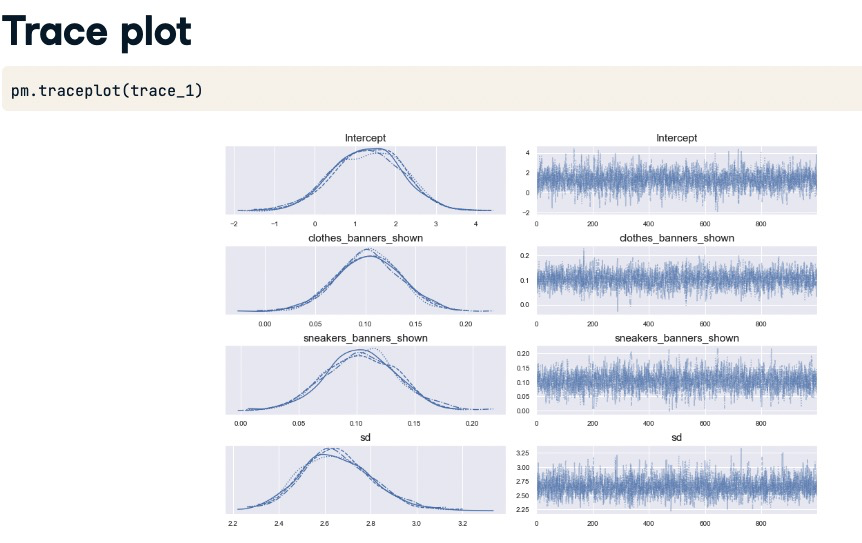

Let's zoom in at one of them. 

On the left, we have the `posterior density plot`. There are four lines on the plot, one for each chain. **The fact that they are all similar indicates they are truly sampled from the right posterior**. 

On the right, we have a line plot of all 4000 draws, separately for each chain. **They oscillate closely around some constant average, which proves good convergence.**

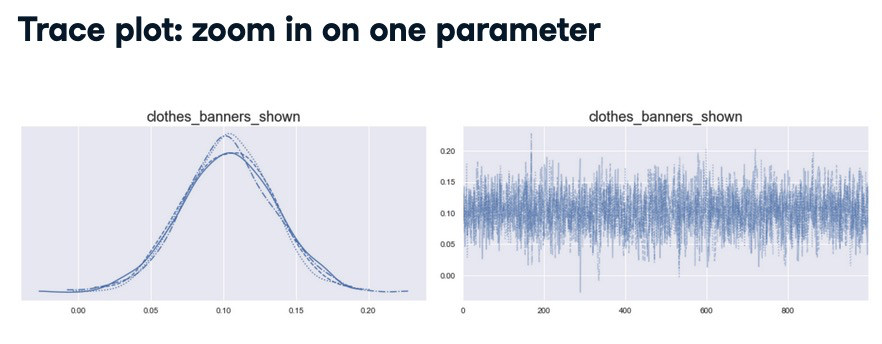

---
#### Forest plot

We can also pass the trace to the forestplot function, which you already know. This time, it will show a separate line for each chain of each parameter. We see that except from the intercept, we are pretty confident about the other parameters' values. 

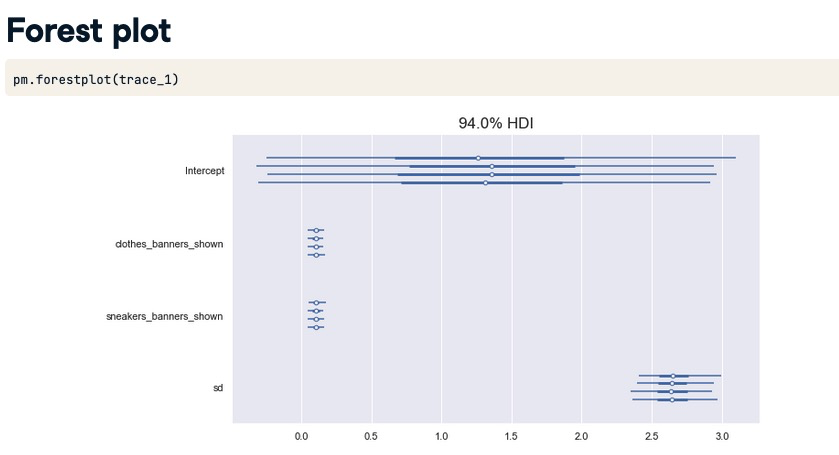

---
#### Trace summary 

To calculate some summary statistics of the posterior draws, we can call `pm.summary` with the trace object passed to it. 

It produces a table with a lot of valuable insights. 

In the first two columns, we can see the mean and the standard deviation of the draws for each parameter. 

Next, we have the ends of the 97% credible interval. It seems that the impact of clothes and sneakers is very similar! 

Finally, take a look at the last column labelled r_hat. This number is only computed if we run more than one chain. **Values of r_hat greater than one indicate that some chains have not converged. Here, we have ones top to bottom, so everything's fine.** 

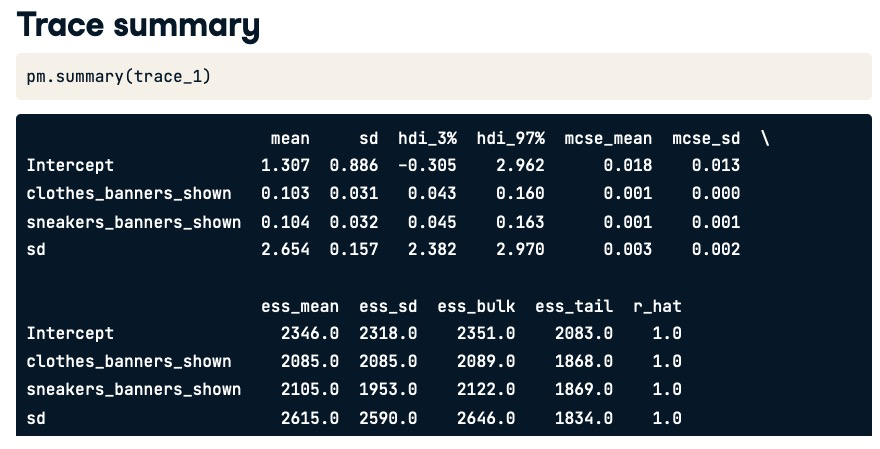

---
#### Fitting another model 

Now, consider another model, let's call it model_2. It's similar to the one before. The only difference is that we add one more explanatory variable: weekend, with a 1 denoting a weekend day, and zero otherwise. 

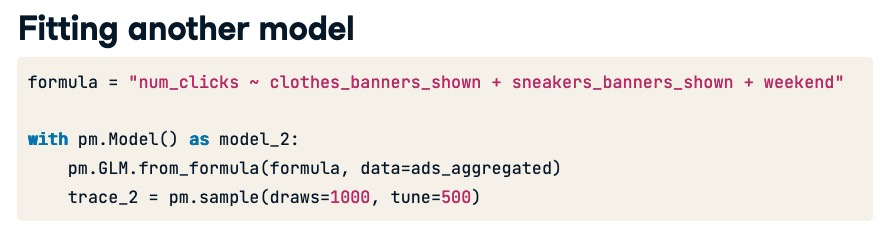

---
#### Widely Applicable Information Criterion (WIAC)

We can compare two models based on the `Widely Applicable Information Criterion, or WAIC`. 

To do so, we gather the model traces in one dictionary and pass it to `pm.compare`, setting `ic` to "waic" and `scale` to "deviance". We can then print the resulting comparison table. 

**WAIC is a measure of model fit. The lower it is, the better the model.** 

Here, model_2 which uses the weekend variable is slightly better than model_1. Since the Bayesian approach is all about probability, we can also calculate the probability of each model being the true model. It is shown in the weight column and suggests that model_2 is slightly better. 

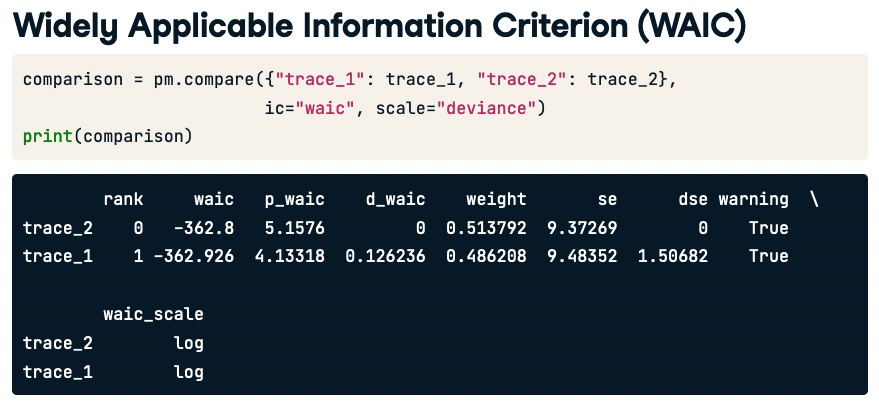

---
#### Compare plot

We can also plot the model comparison with `pm.compareplot`. 

The empty circles show the `WAIC values for each model` and the black error bars associated with them show their standard deviations. For all but the top model, we also get a gray triangle indicating the difference in WAIC between that model and the top one. 

The standard deviation error bars show we are not that confident in the superiority of model_2. 

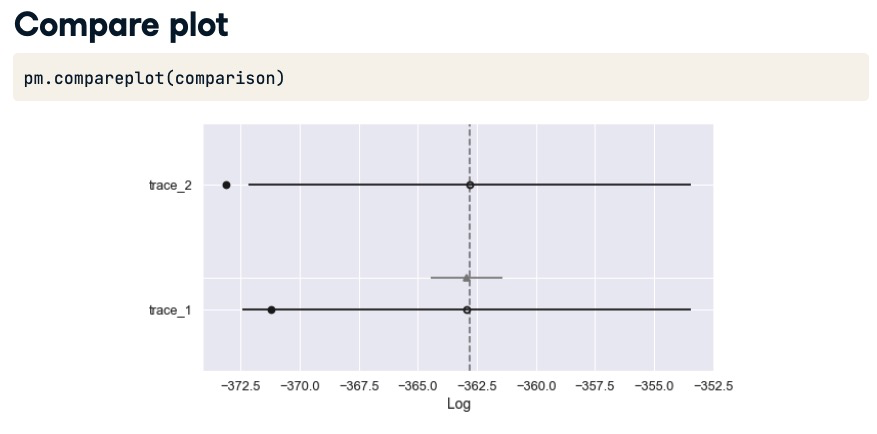

---
### Exercise: Comparing models with WAIC

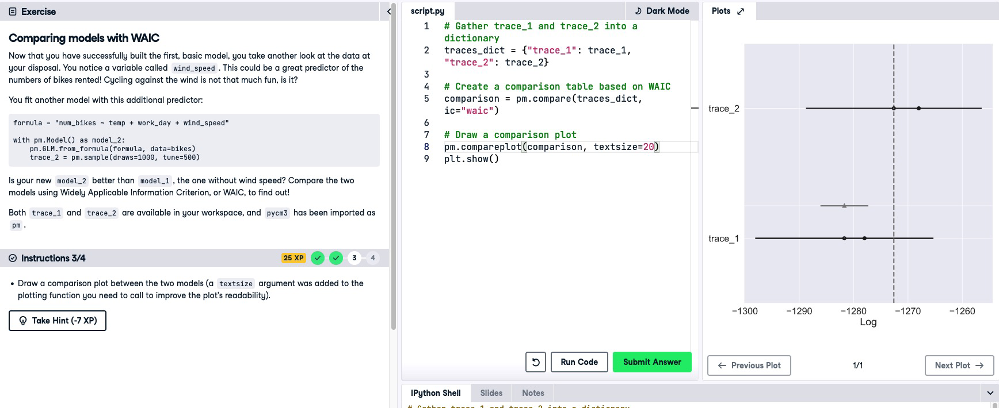

#### Take away:

Take a look at the gray triangle in the compare plot. It shows the difference in WAIC between the two models, and both ends of its whiskers lay at lower values then model_2's WAIC.

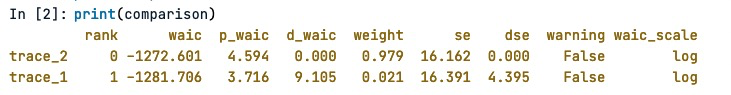

The weight of 0.021 for model_1 indicates it is the true model with around 2% probability.

---
## Making predictions 

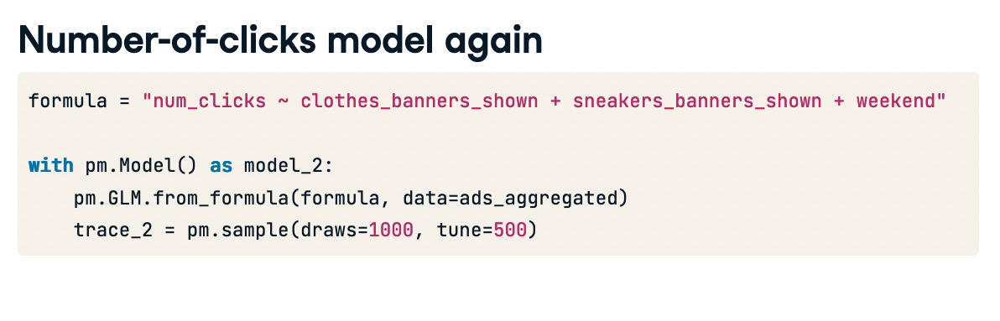

#### Now we have a new data called ads_test, which has 5 observations that we did not use to fit the model. For each of the new observations, we know the true number of clicks. So we can compare it with the model's predictions to see how accurate they are. 

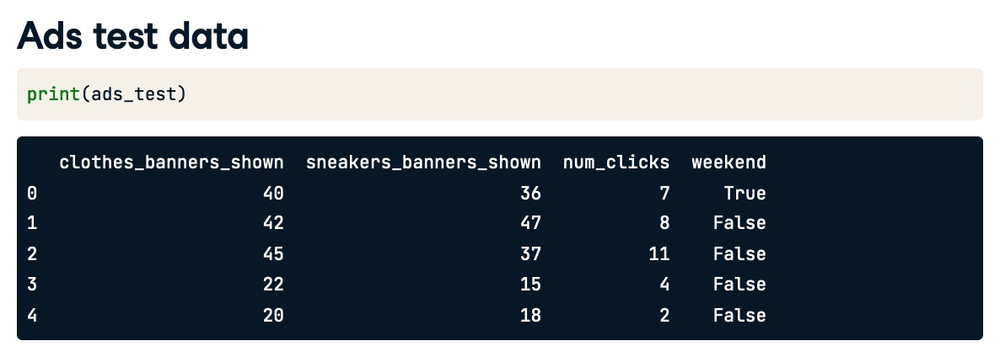

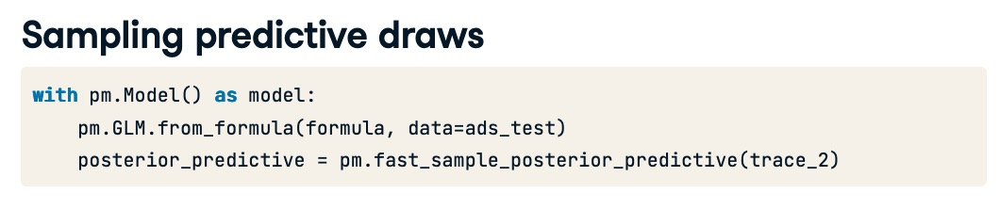

#### pymc3 denotes the response variable in a regression model with "y", so we need to extract it from posterior_predictive. 

#### We can see that "y" has 4000 rows and 5 columns. The 5 columns correspond to the five observations in our test data for which the predictions have been generated. For each test observation, there are 4000 predictive draws, which corresponds to the settings we chose when fitting the model: 1000 draws and 4 chains. 

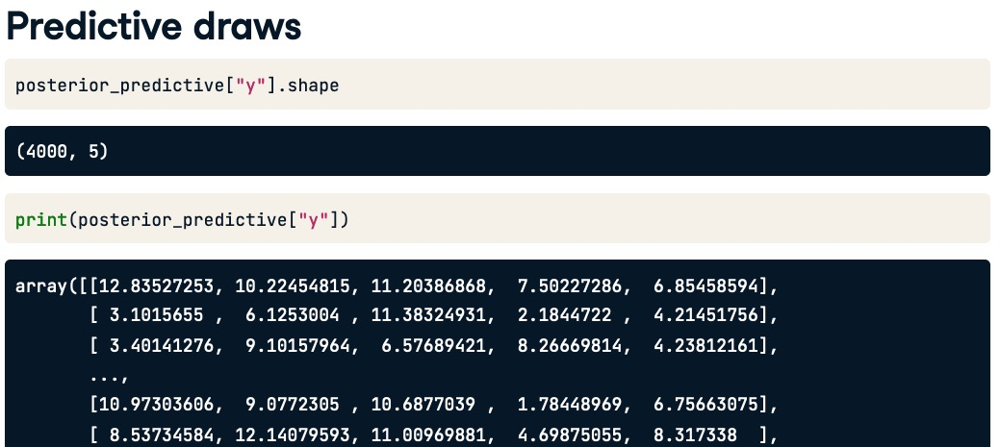

### How good is the prediction?

The num_clicks for the first observation is 7. We pass the predictive draws of the first observation to plot_posterior. The posterior mean is 9.7, and we are 94% sure the value should be between 4.4 and 15. 

This is just for one single test observation. It would be much more useful to estimate the model's error in general, based on many test examples. 

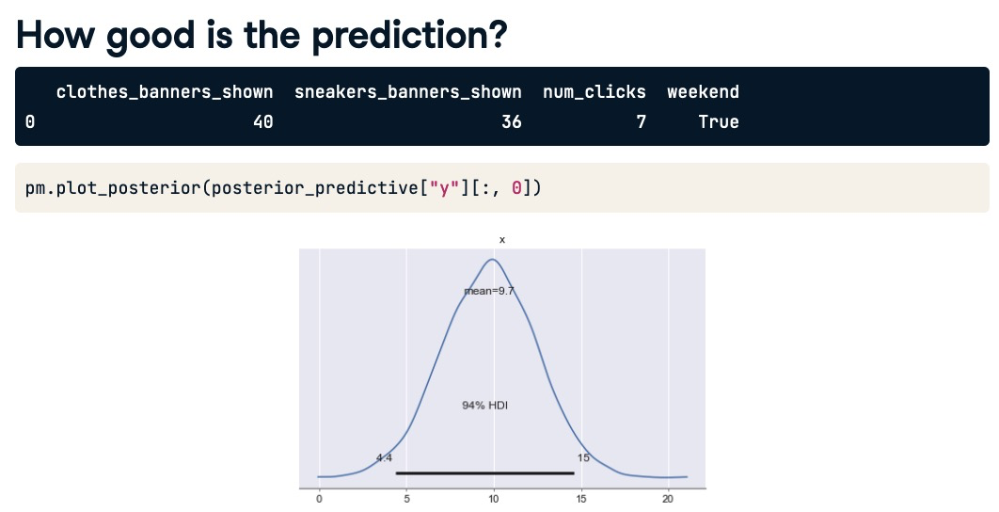

### Test error distribution 

We start by creating an empty list called errors to store the errors for subsequent test observations. We then iterate over the rows of ads_test using the iterrows method. 

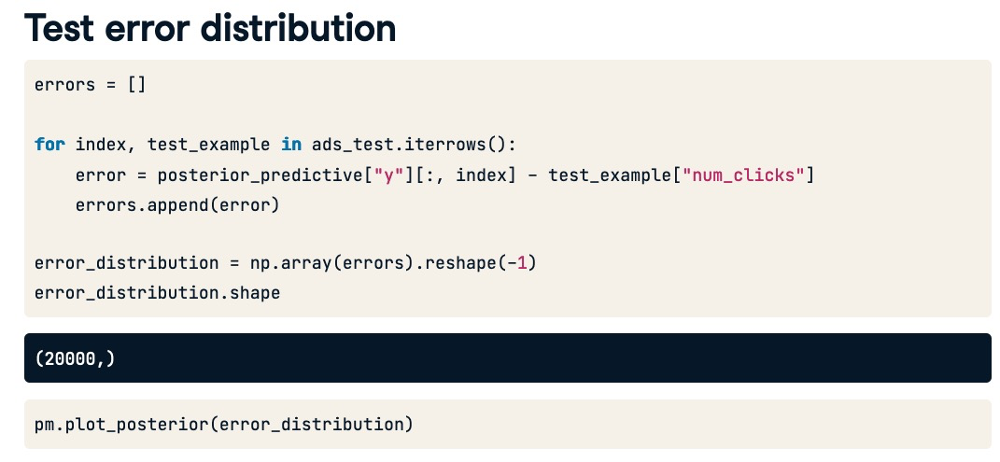

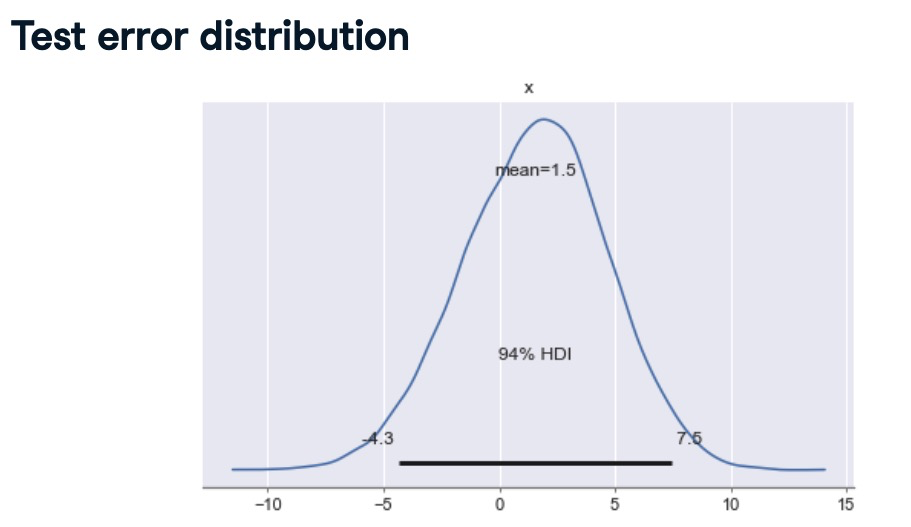

On average, our predictions are off by 1.5 clicks, and we are more likely to predict too many than too few. 

---
### Exercise: bike data 

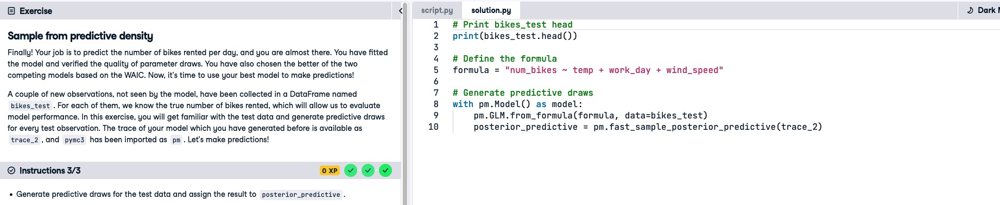


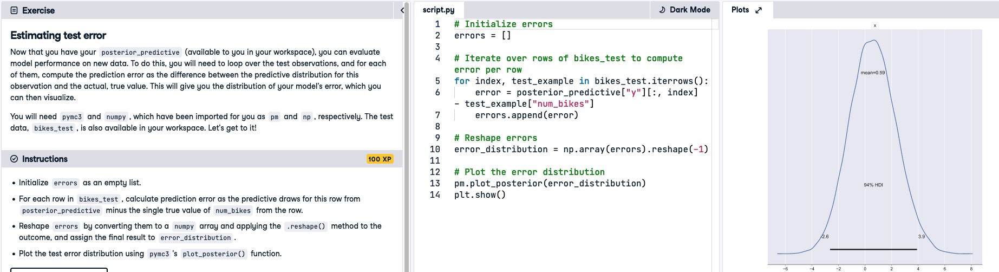
#### Take-home:
In practice, you might want to compute the error estimate based on more than just 10 observations, but you can already see some patterns. For example, the error is more often positive than negative, which means that the model tends to overpredict the number of bikes rented!

---
## How much is an avocado?

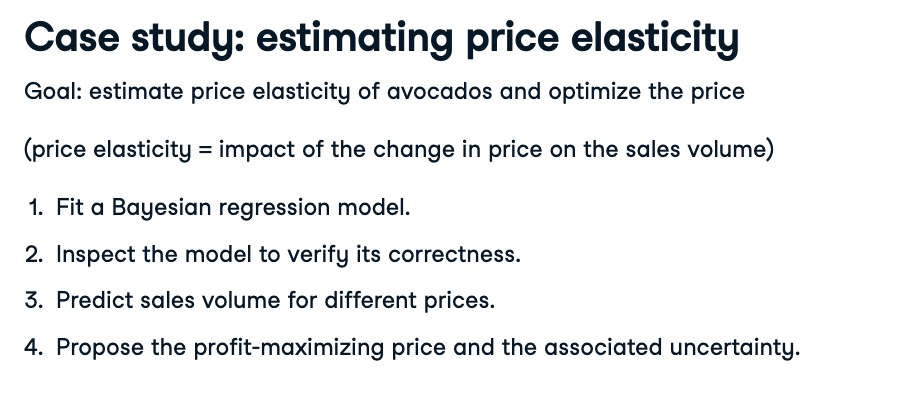

### Avocado data

In [15]:
file_avocado = 'avocado.csv'
avocado = pd.read_csv(path + file_avocado)

In [16]:
avocado.head()

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany


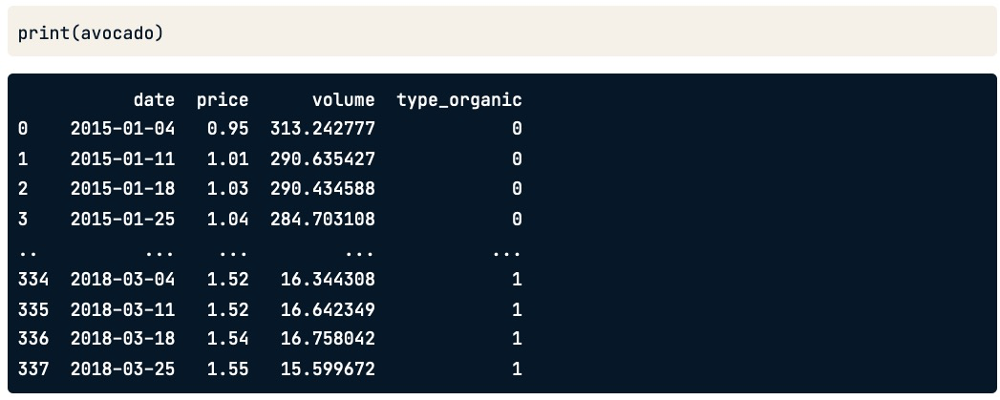

### Specifying priors in pymc3 models


Below is the model we set up for the bike data. We've said that since the priors are not specified, the model will just use the pretty good defaults. 


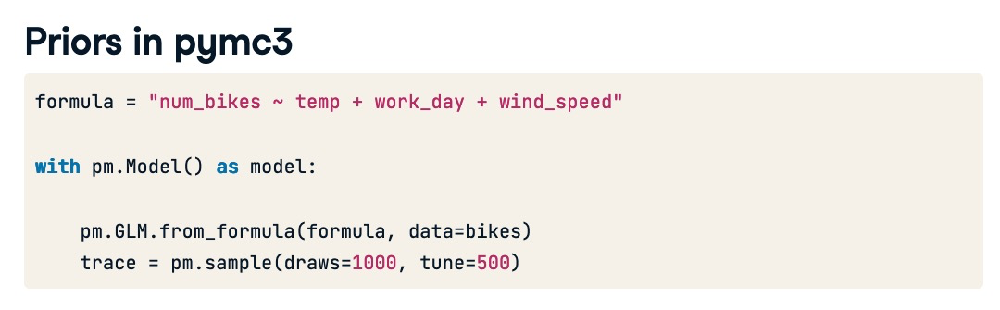

Say we expect the effect of wind speed to be negative and we would like to have a normal distribution with a mean of -5 as a prior for this variable. All we have to do is to create a dictionary with the variable name as key, and the desired prior distribution as value. 

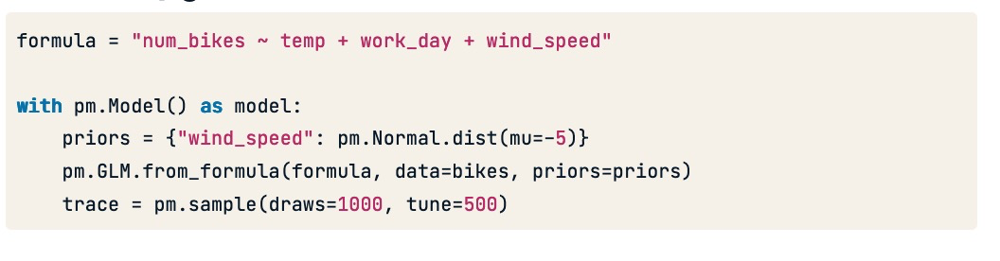

### Extracting draws from trace

How to extract the posterior draws for a particular parameter from the trace?

We call the `.get_values` method on the trace with the variable name as the argument. This returns a numpy array with posterior draws for this variable, from all chains combined. 

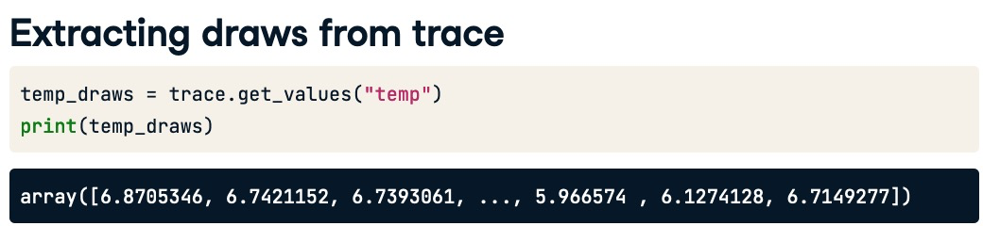

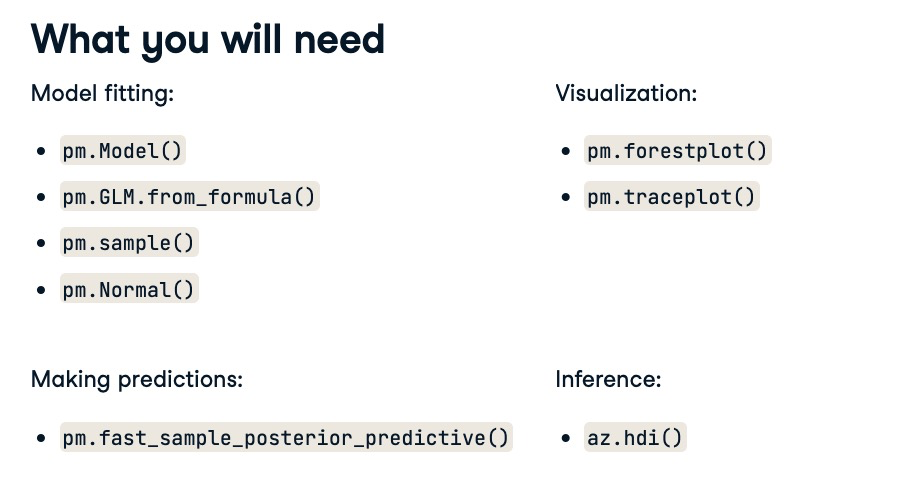

---
### Exercise

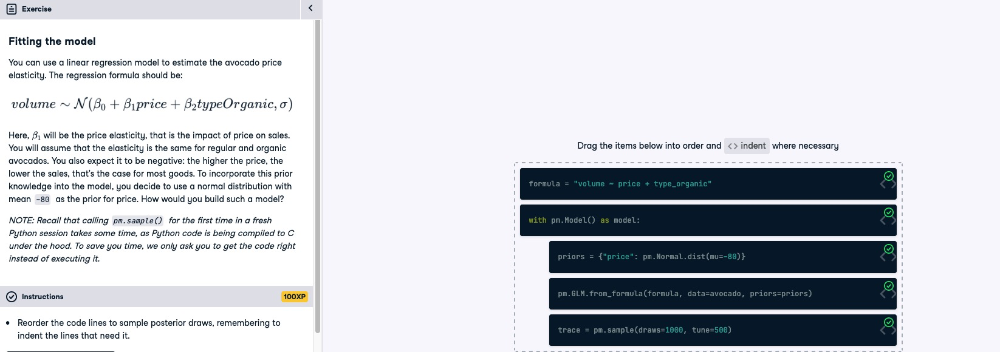

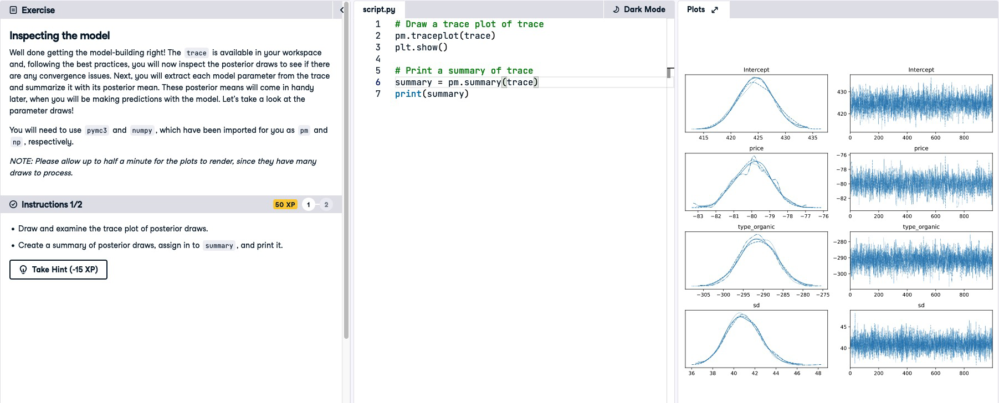

---
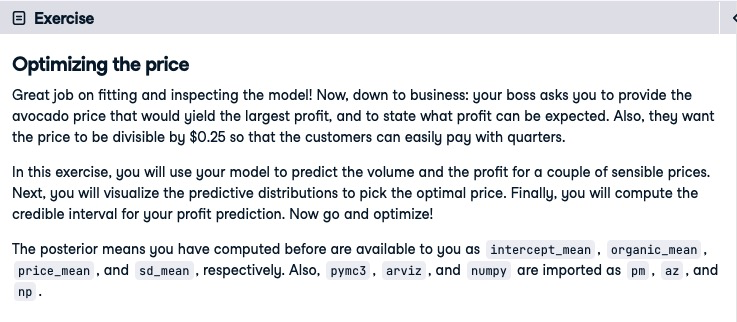

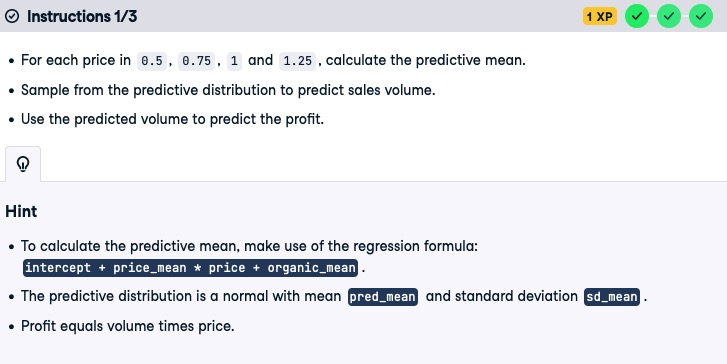

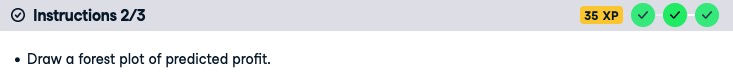

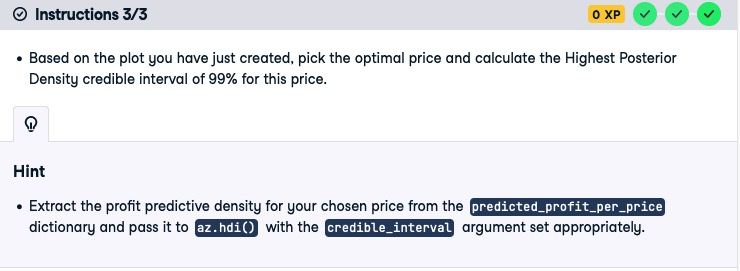

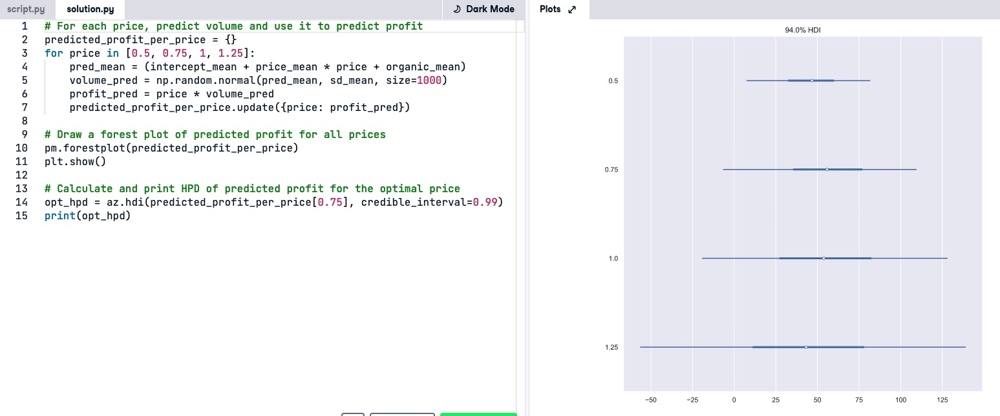

#### Take-home:
With a higher or lower price, your company would lose profit, but thanks to your modeling skills, they were able to set the best possible price. More than that, knowing the uncertainty in the profit prediction, they can prepare for the worst-case scenario (in which the profit is negative)! 

---
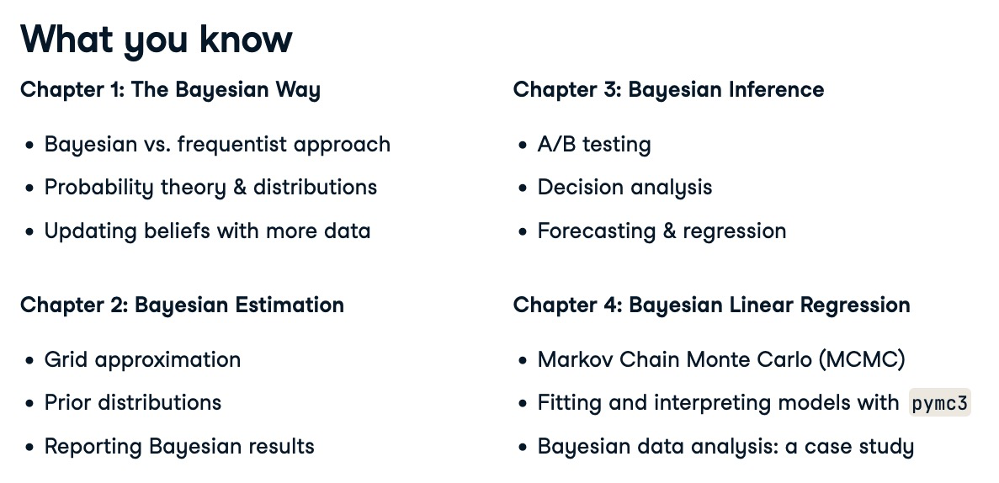

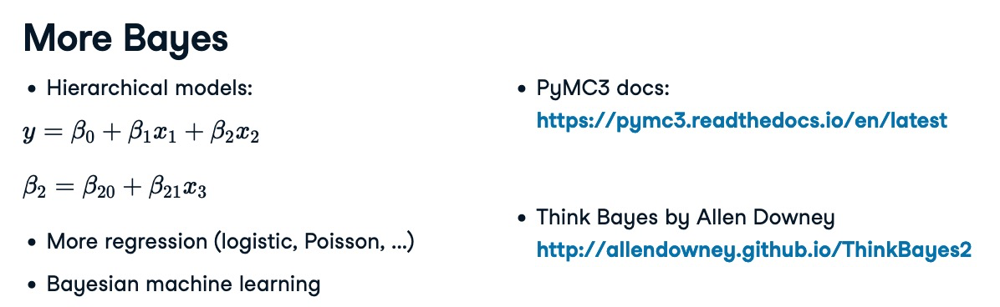